In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn import manifold
from sklearn.metrics.pairwise import rbf_kernel
from skimage import io, color, transform
from scipy.fftpack import fft2, fftshift, ifft2, ifftshift
from scipy.stats import permutation_test
from scipy.spatial.distance import pdist, squareform
import umap
import os
import json
from pathlib import Path
from tqdm import tqdm
import torch
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from torchvision import transforms


d:\IPTP\Stage_3A\Stage\Code\.venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## PCA

In [102]:
def load_images(folder, target_size=(256, 256), max_samples=1000, grey = True):
    images = []
    expect_shape = target_size if grey else (target_size[0], target_size[1], 3)
    for filename in tqdm(os.listdir(folder)[:max_samples]):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            try:
                img = Image.open(os.path.join(folder, filename))
                if grey:
                    img = img.convert('L')  
                    img_resized = np.array(img.resize(target_size)) / 255.0  
                else:
                    img = img.convert('RGB')  
                    img_resized = np.array(img.resize(target_size)) / 255.0
                assert img_resized.shape == expect_shape
                images.append(img_resized)
            except Exception as e:
                print(f"Skipped {filename}: {str(e)}")
    return np.array(images)

In [103]:
def load_images_nature(folder, size = 256, max_samples = 1000, grey = True):
    images = []
    transform = transforms.Compose([transforms.Resize(size), transforms.CenterCrop(size)])
    expect_shape = (size,size) if grey else (size,size,3)
    for filename in tqdm(os.listdir(folder)[:max_samples]):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            try:
                img = Image.open(os.path.join(folder, filename))
                img = transform(img)
                if grey:
                    img = img.convert('L')  
                    img_resized = np.array(img) / 255.0  
                else:
                    img = img.convert('RGB')    
                    img_resized = np.array(img) / 255.0
                assert img_resized.shape == expect_shape
                images.append(img_resized)
            except Exception as e:
                print(f"Skipped {filename}: {str(e)}")
    return np.array(images)

In [14]:
def plot_pca_components(pca_result, labels, explained_variance, path):
    os.makedirs(os.path.dirname(path),exist_ok = True)
    plt.figure(figsize=(12, 5))
    
    plt.subplot(121)
    plt.scatter(pca_result[labels==1, 0], pca_result[labels==1, 1], alpha=0.5, label="Real")
    plt.scatter(pca_result[labels==0, 0], pca_result[labels==0, 1], alpha=0.5, label="AI")
    plt.title(f"Top 2 PCs (Total Var: {explained_variance[:2].sum():.1%})")
    plt.xlabel(f"PC1 ({explained_variance[0]:.1%})")
    plt.ylabel(f"PC2 ({explained_variance[1]:.1%})")
    
    plt.subplot(122)
    plt.scatter(pca_result[labels==1, -2], pca_result[labels==1, -1], alpha=0.5, label="Real")
    plt.scatter(pca_result[labels==0, -2], pca_result[labels==0, -1], alpha=0.5, label="AI")
    plt.title(f"Bottom 2 PCs (Total Var: {explained_variance[-2:].sum():.1%})")
    plt.xlabel(f"PC{len(explained_variance)-1} ({explained_variance[-2]:.1%})")
    plt.ylabel(f"PC{len(explained_variance)} ({explained_variance[-1]:.1%})")
    
    plt.legend()
    plt.tight_layout()    
    plt.savefig(path)
    plt.close()
    # plt.show()

In [8]:
def pca_transform(input_path_ai,input_path_nature, output_path, n_components = 64, size = 256, max_samples = 1000, grey = True):
    ai_imgs = load_images(input_path_ai,(size,size),max_samples,grey)
    # ai_imgs = ai_imgs.reshape(len(ai_imgs), -1)
    nature_imgs = load_images_nature(input_path_nature,size,max_samples,grey)
    # nature_imgs = nature_imgs.reshape(len(nature_imgs), -1)
    print(ai_imgs.shape, nature_imgs.shape)
    all_imgs = np.concatenate([nature_imgs, ai_imgs])
    all_imgs = all_imgs.reshape(len(all_imgs), -1)  # (n_samples, H*W(*3))
    labels = np.array([1]*len(nature_imgs) + [0]*len(ai_imgs))
    pca = PCA(n_components = n_components)
    pca_result = pca.fit_transform(all_imgs)
    plot_pca_components(pca_result, labels, pca.explained_variance_ratio_, output_path)
    return pca, pca_result


In [3]:
with open("classes.json", "r", encoding="utf-8") as f:
    data = json.load(f)
classes_idx = data["1k_idx"]
classes_names = data["21k_idx"]

100%|██████████| 162/162 [00:01<00:00, 84.69it/s]


(162, 256, 256) (162, 256, 256)


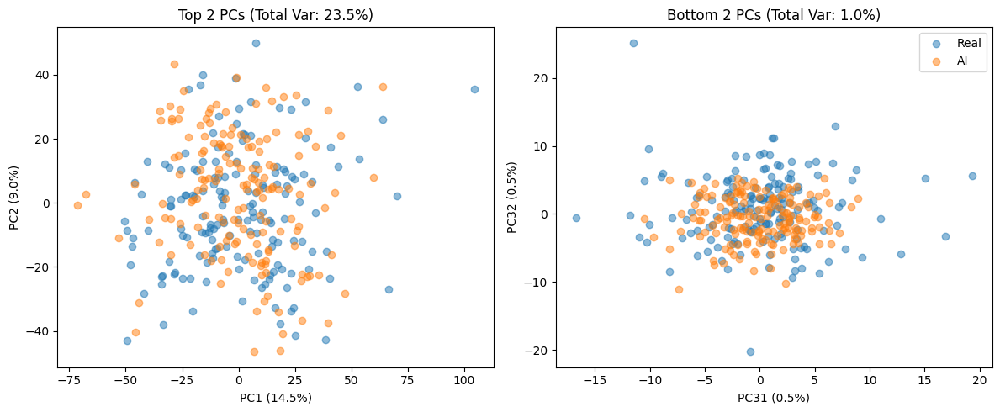

100%|██████████| 162/162 [00:00<00:00, 181.15it/s]


(162, 256, 256) (162, 256, 256)


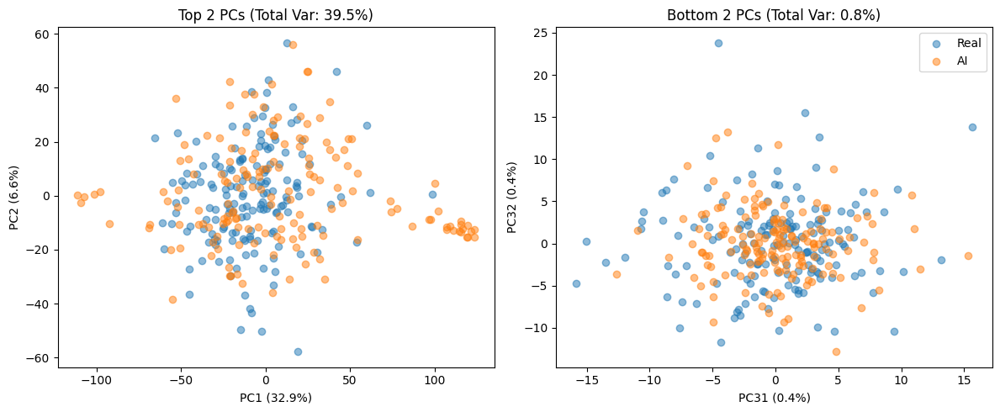

100%|██████████| 162/162 [00:00<00:00, 193.30it/s]


(162, 256, 256) (162, 256, 256)


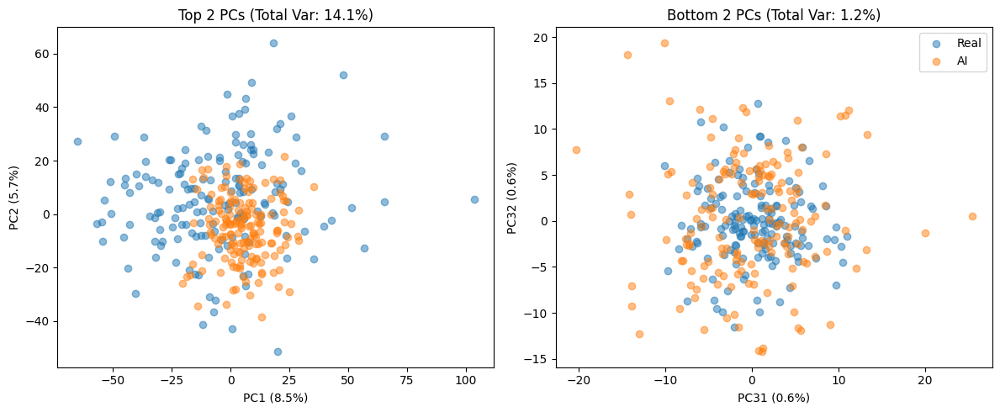

100%|██████████| 162/162 [00:00<00:00, 190.89it/s]


(162, 256, 256) (162, 256, 256)


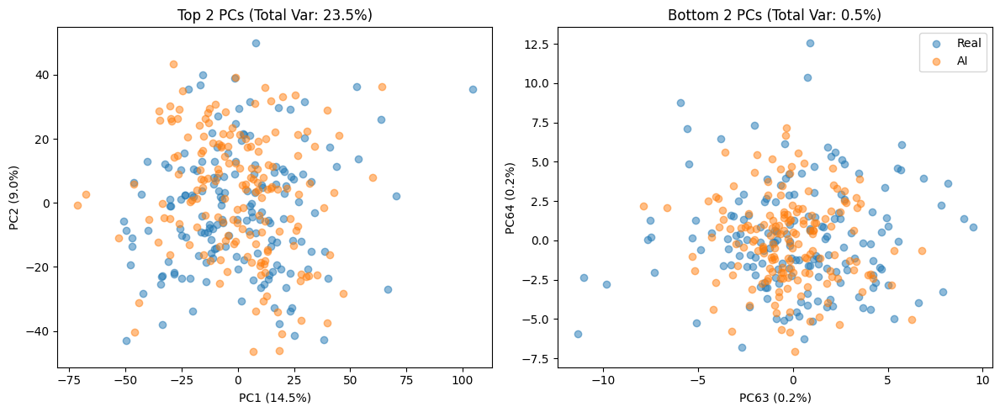

100%|██████████| 162/162 [00:00<00:00, 190.90it/s]


(162, 256, 256) (162, 256, 256)


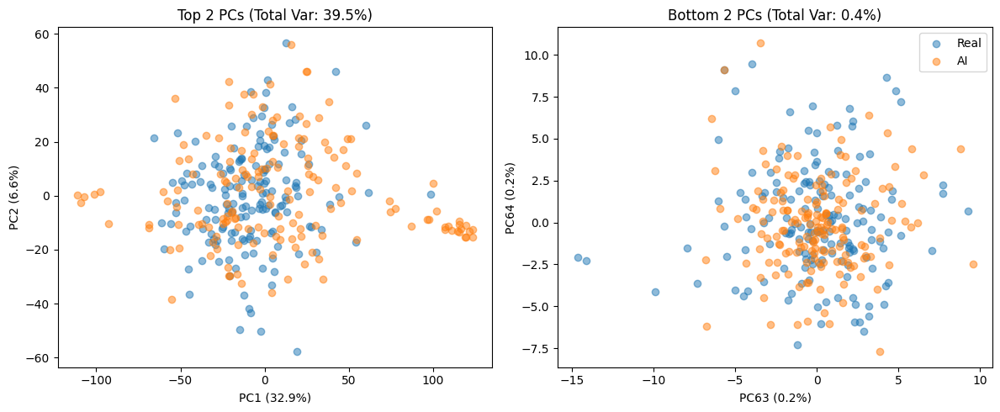

100%|██████████| 162/162 [00:00<00:00, 200.66it/s]


(162, 256, 256) (162, 256, 256)


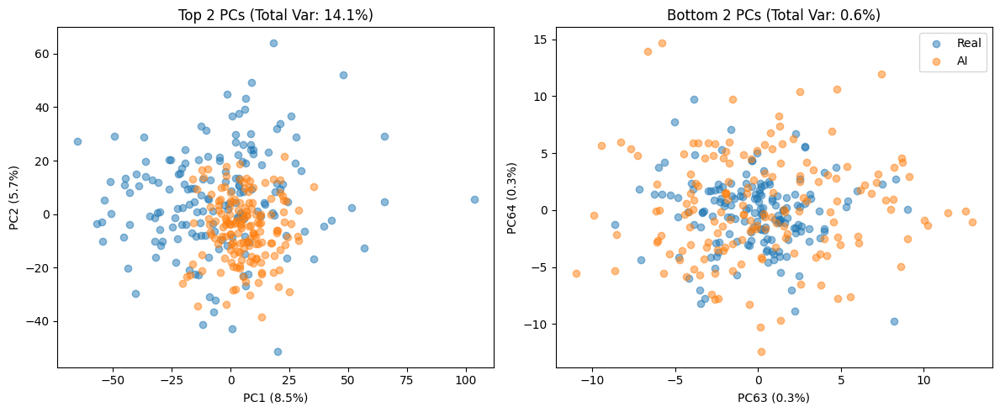

100%|██████████| 162/162 [00:01<00:00, 99.23it/s] 


(162, 256, 256) (162, 256, 256)


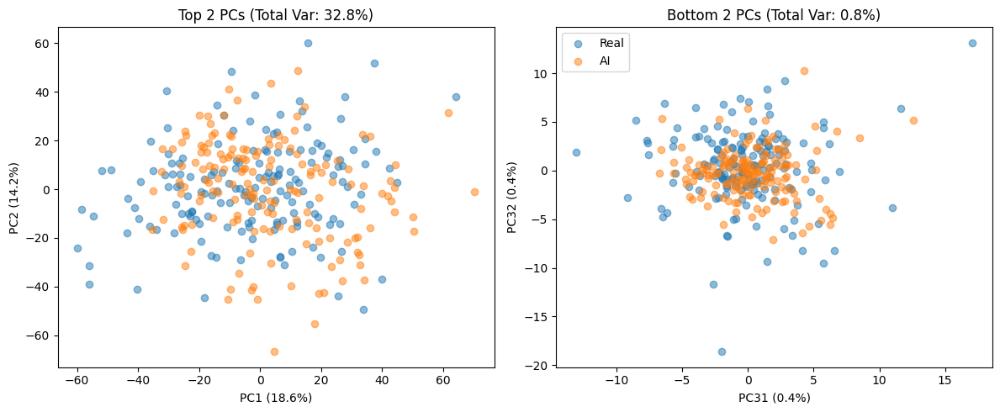

100%|██████████| 162/162 [00:00<00:00, 258.06it/s]


(162, 256, 256) (162, 256, 256)


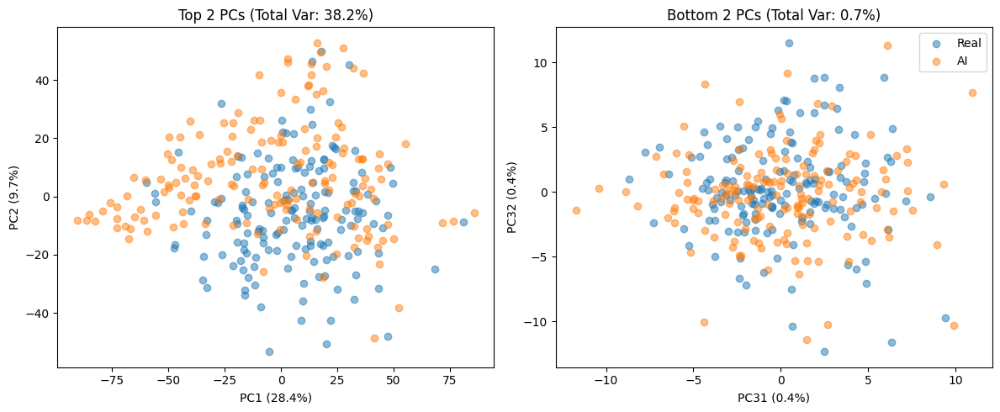

100%|██████████| 162/162 [00:00<00:00, 246.07it/s]


(162, 256, 256) (162, 256, 256)


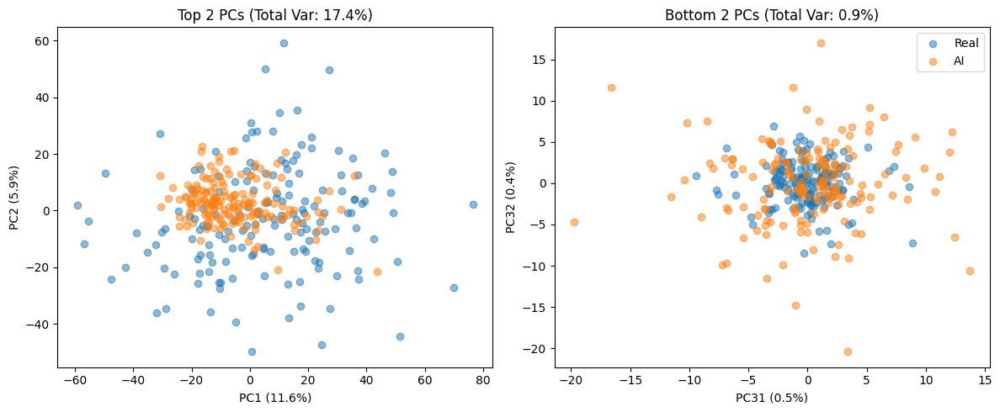

100%|██████████| 162/162 [00:00<00:00, 248.50it/s]


(162, 256, 256) (162, 256, 256)


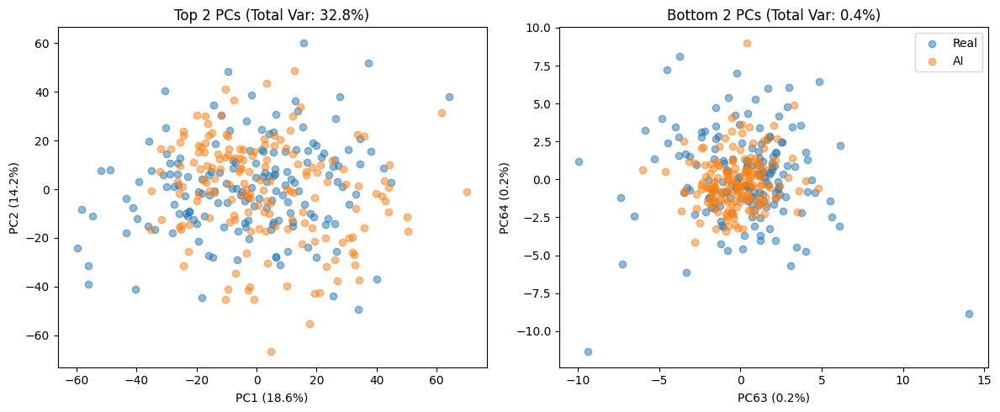

100%|██████████| 162/162 [00:00<00:00, 256.62it/s]


(162, 256, 256) (162, 256, 256)


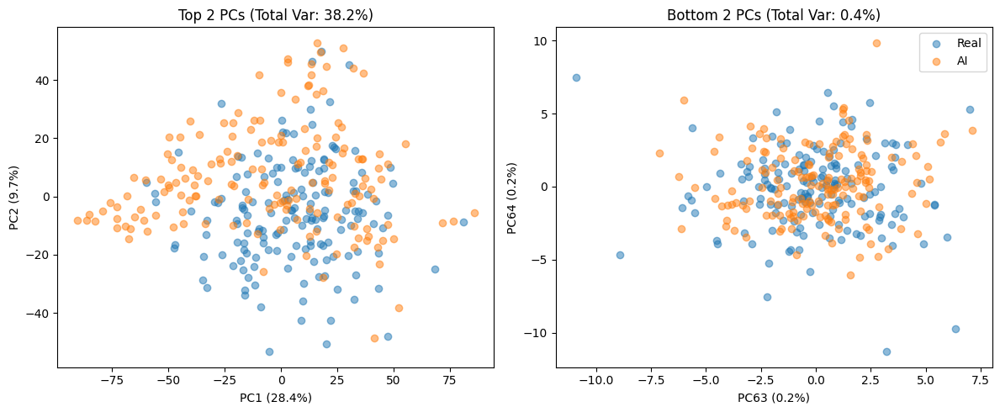

100%|██████████| 162/162 [00:00<00:00, 256.00it/s]


(162, 256, 256) (162, 256, 256)


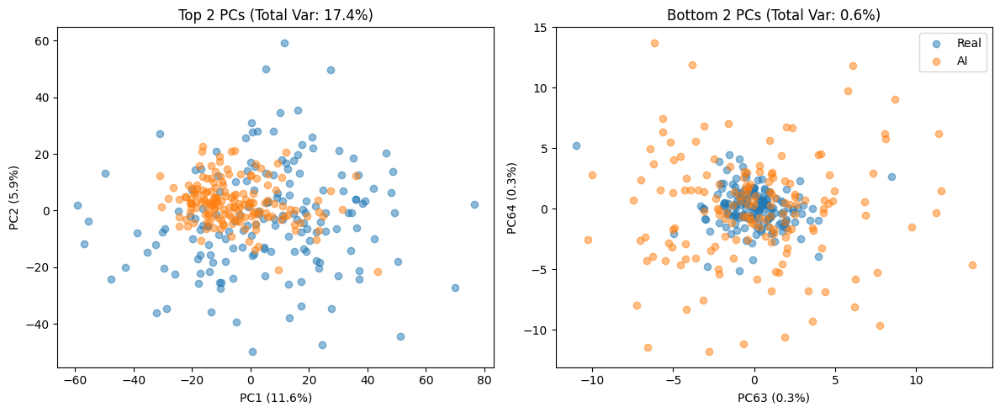

100%|██████████| 162/162 [00:01<00:00, 95.13it/s]


(162, 256, 256) (162, 256, 256)


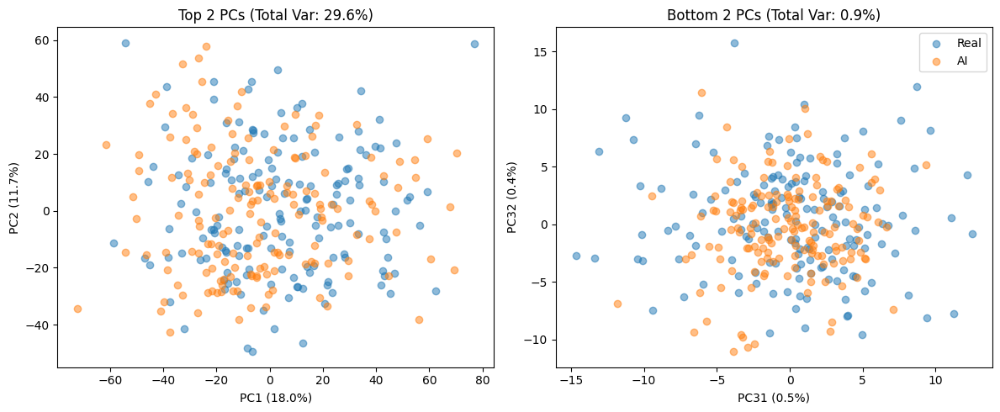

100%|██████████| 162/162 [00:00<00:00, 224.92it/s]


(162, 256, 256) (162, 256, 256)


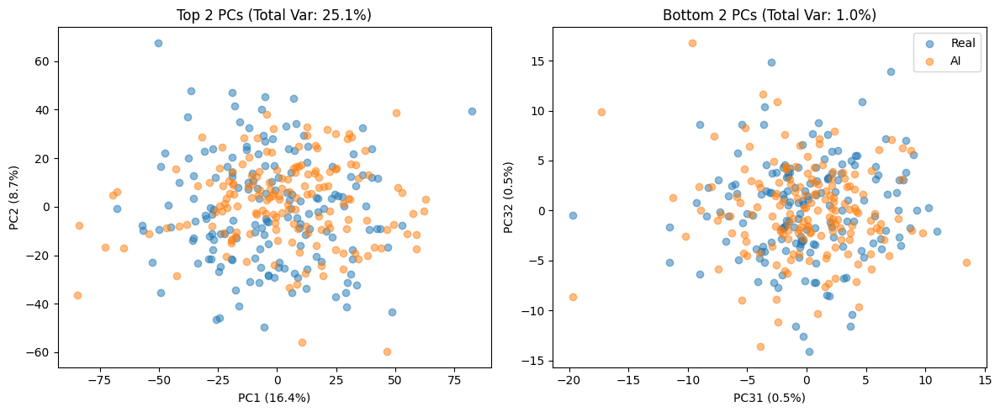

100%|██████████| 162/162 [00:00<00:00, 226.92it/s]


(162, 256, 256) (162, 256, 256)


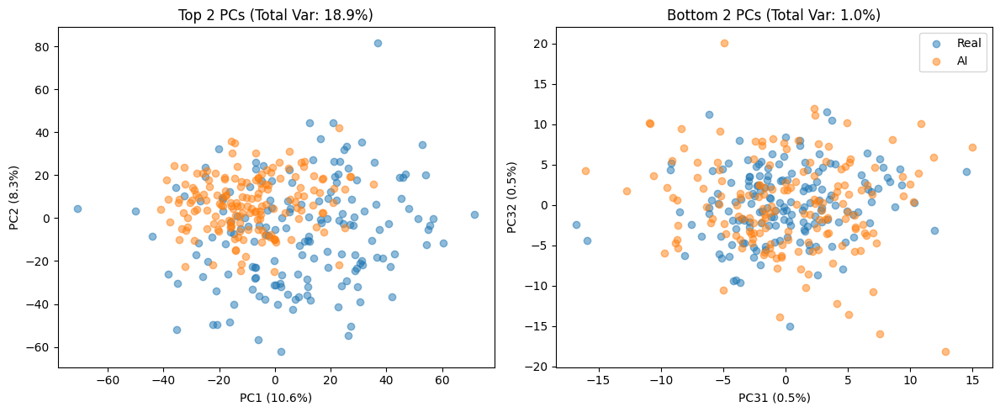

100%|██████████| 162/162 [00:00<00:00, 206.58it/s]


(162, 256, 256) (162, 256, 256)


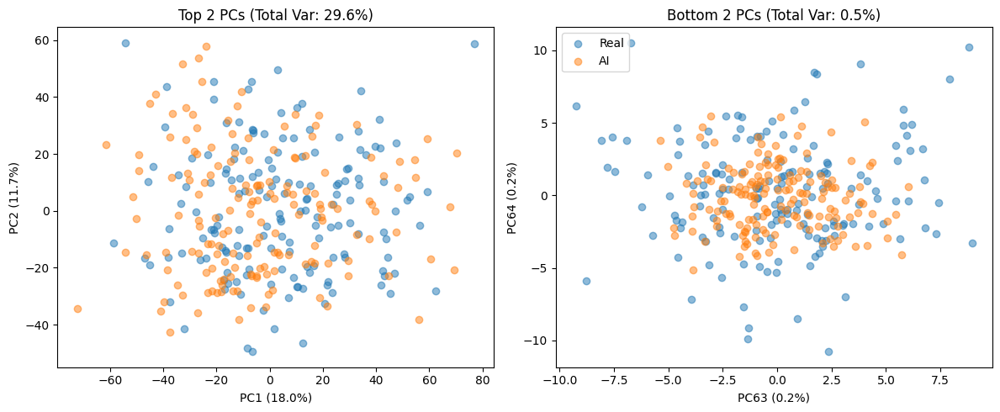

100%|██████████| 162/162 [00:00<00:00, 209.04it/s]


(162, 256, 256) (162, 256, 256)


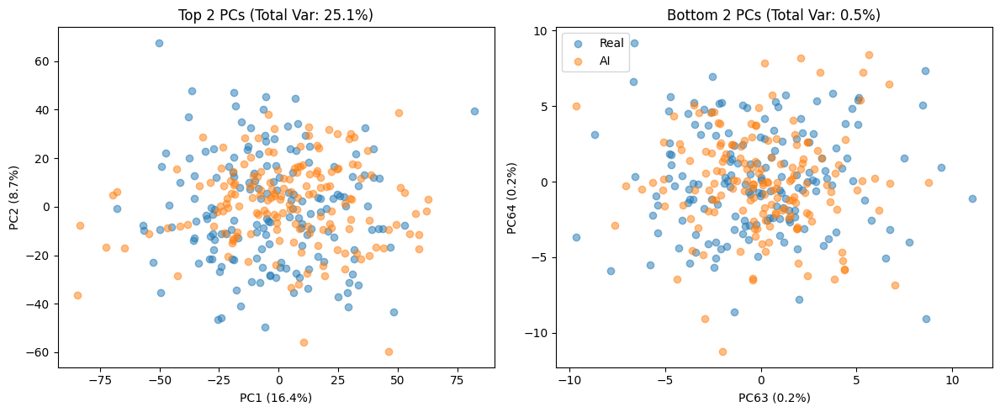

100%|██████████| 162/162 [00:00<00:00, 205.48it/s]


(162, 256, 256) (162, 256, 256)


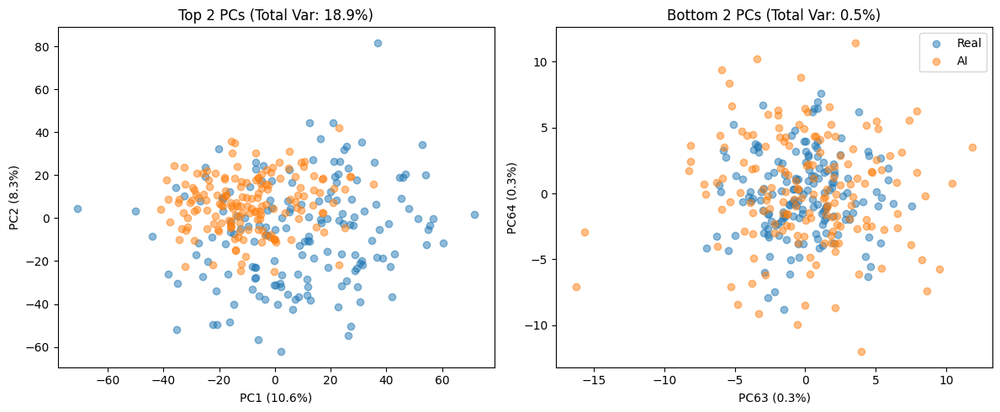

100%|██████████| 162/162 [00:01<00:00, 91.23it/s]


(162, 256, 256) (162, 256, 256)


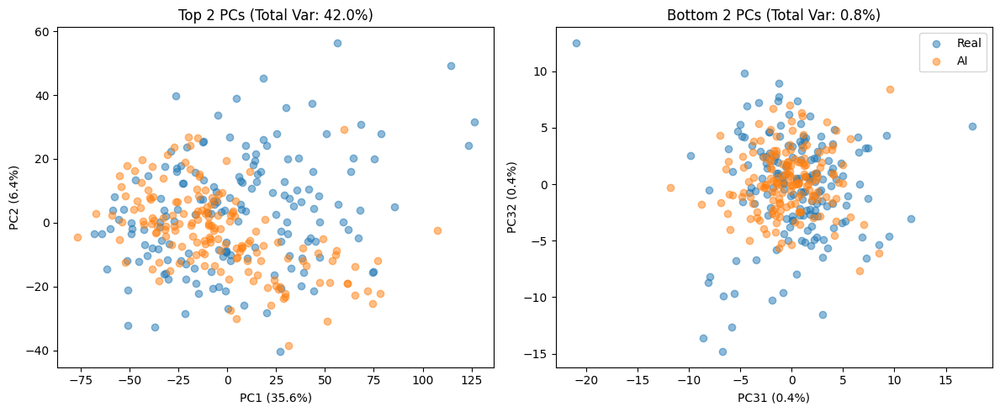

100%|██████████| 162/162 [00:00<00:00, 282.63it/s]


(162, 256, 256) (162, 256, 256)


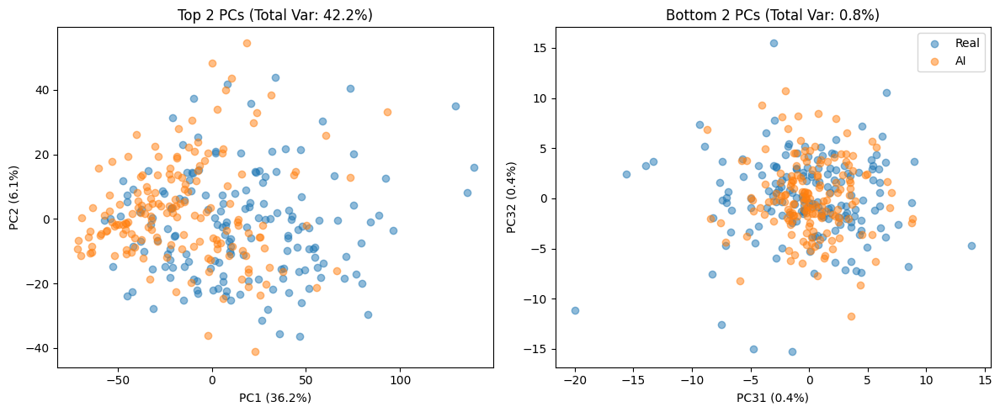

100%|██████████| 162/162 [00:00<00:00, 242.81it/s]


(162, 256, 256) (162, 256, 256)


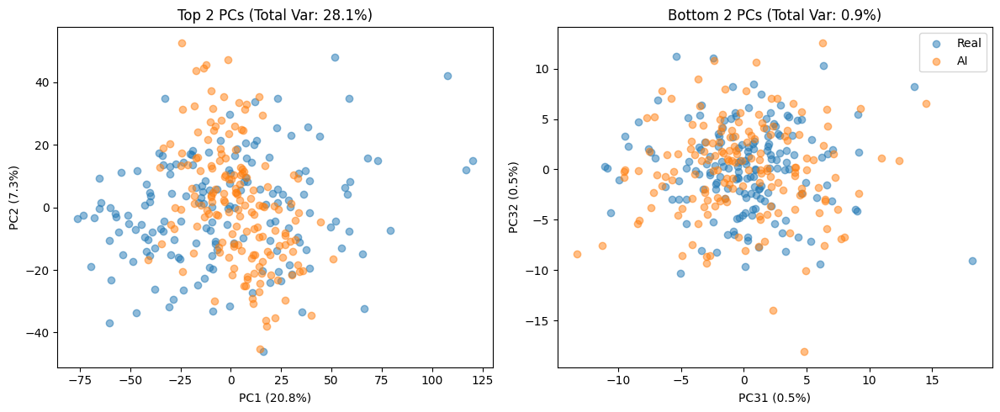

100%|██████████| 162/162 [00:00<00:00, 267.12it/s]


(162, 256, 256) (162, 256, 256)


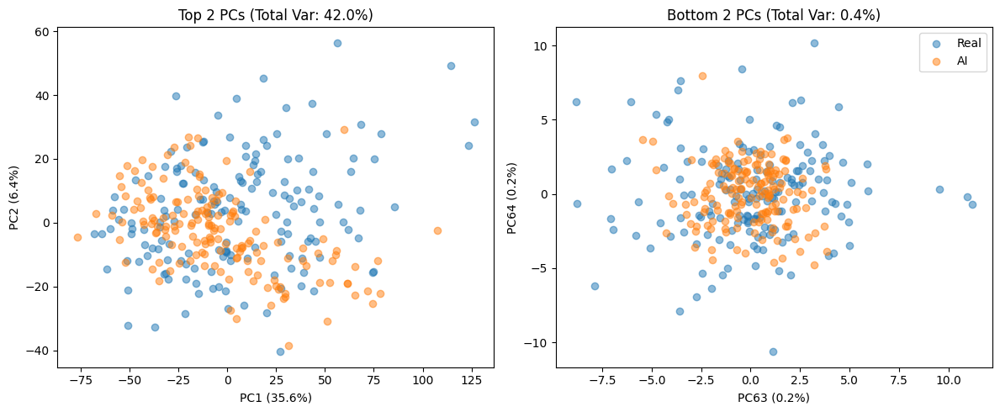

100%|██████████| 162/162 [00:00<00:00, 256.55it/s]


(162, 256, 256) (162, 256, 256)


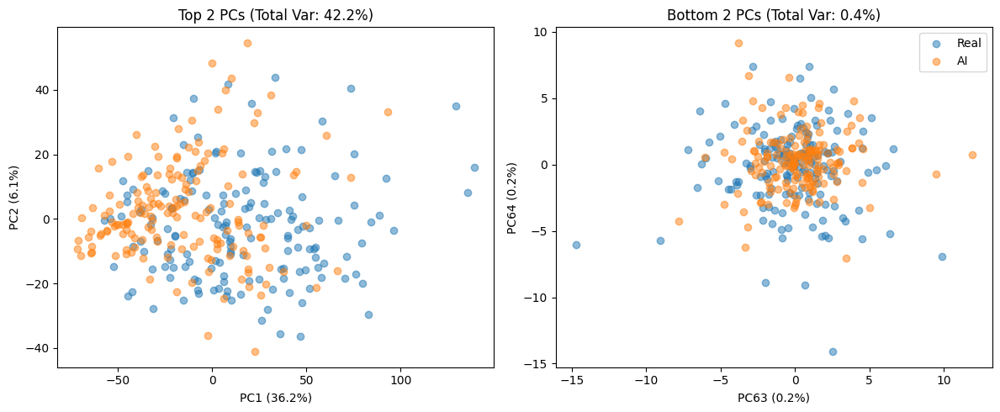

100%|██████████| 162/162 [00:00<00:00, 262.98it/s]


(162, 256, 256) (162, 256, 256)


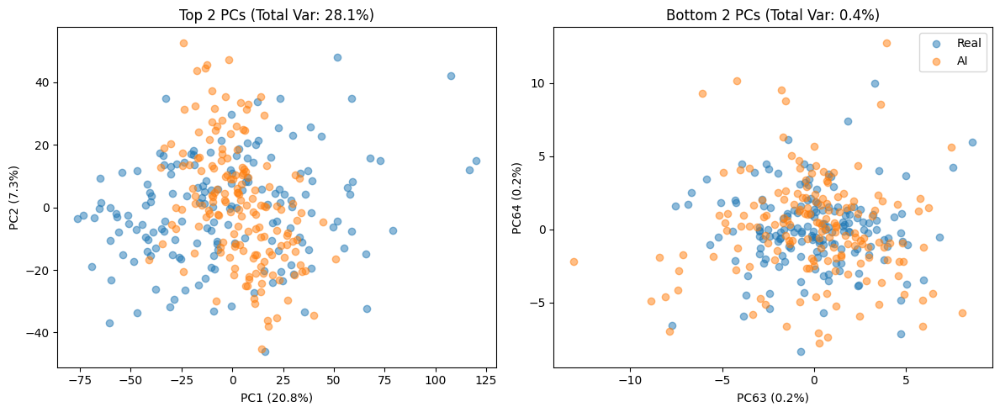

100%|██████████| 162/162 [00:01<00:00, 92.25it/s]


(162, 256, 256) (162, 256, 256)


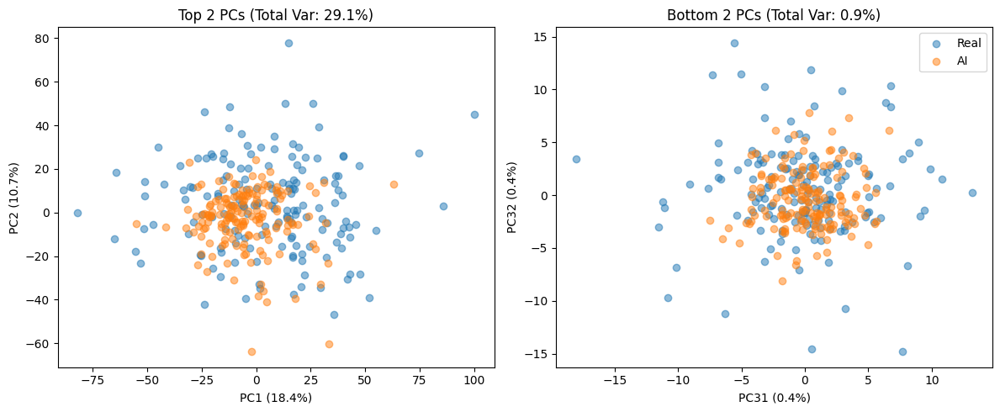

100%|██████████| 162/162 [00:00<00:00, 262.50it/s]


(162, 256, 256) (162, 256, 256)


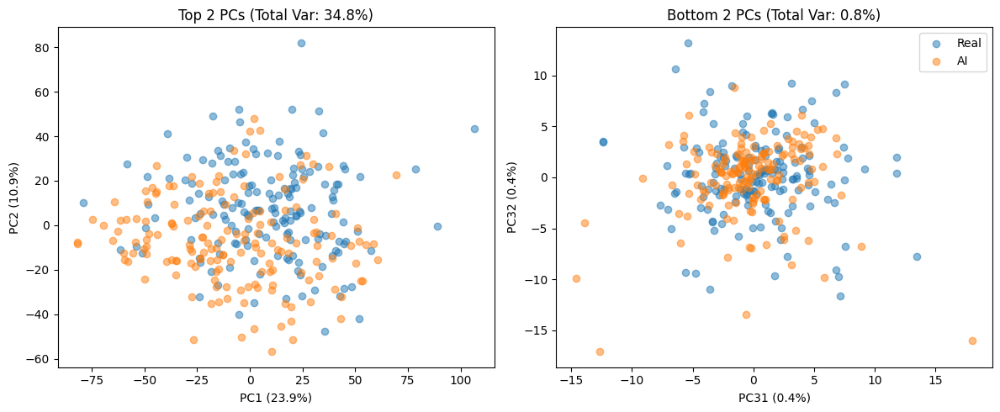

100%|██████████| 162/162 [00:00<00:00, 251.56it/s]


(162, 256, 256) (162, 256, 256)


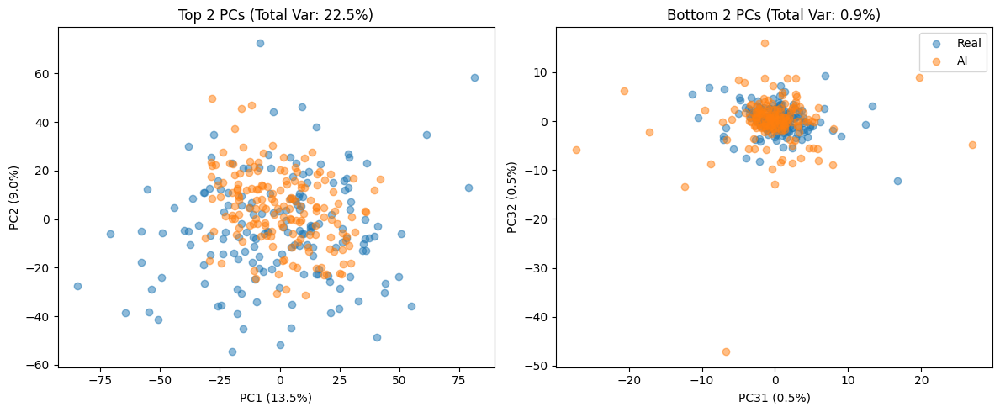

100%|██████████| 162/162 [00:00<00:00, 241.68it/s]


(162, 256, 256) (162, 256, 256)


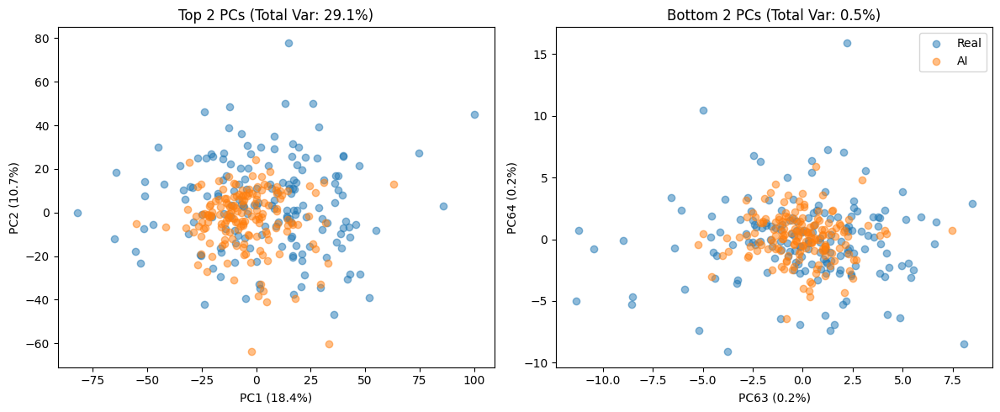

100%|██████████| 162/162 [00:00<00:00, 226.19it/s]


(162, 256, 256) (162, 256, 256)


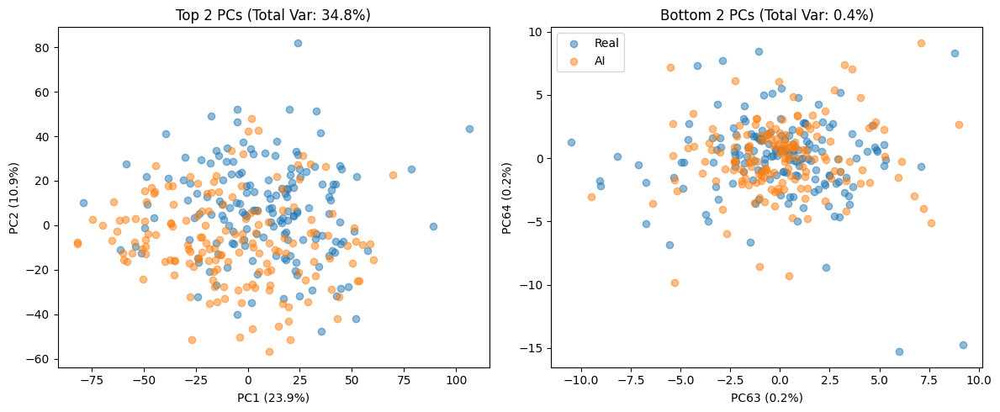

100%|██████████| 162/162 [00:00<00:00, 209.82it/s]


(162, 256, 256) (162, 256, 256)


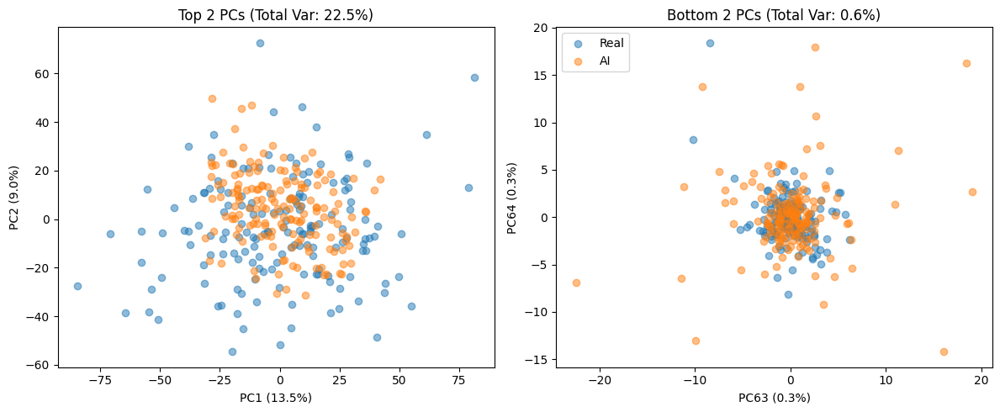

100%|██████████| 162/162 [00:01<00:00, 99.43it/s] 


(162, 256, 256) (162, 256, 256)


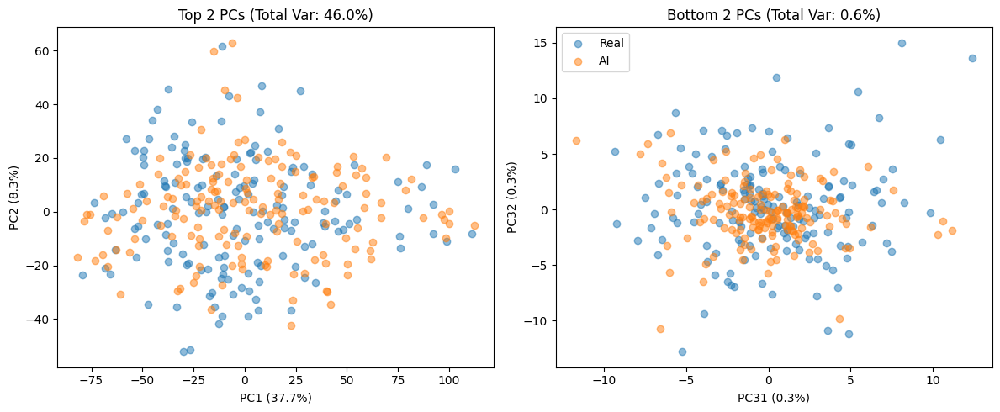

100%|██████████| 162/162 [00:00<00:00, 272.52it/s]


(162, 256, 256) (162, 256, 256)


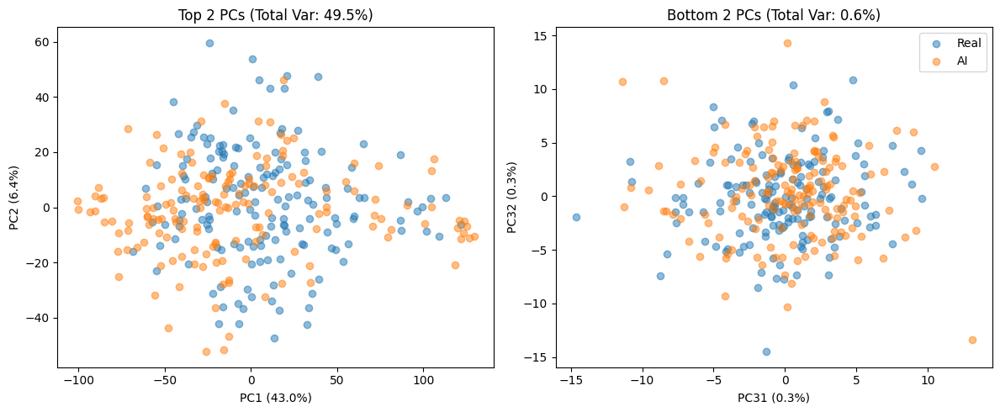

100%|██████████| 162/162 [00:00<00:00, 268.74it/s]


(162, 256, 256) (162, 256, 256)


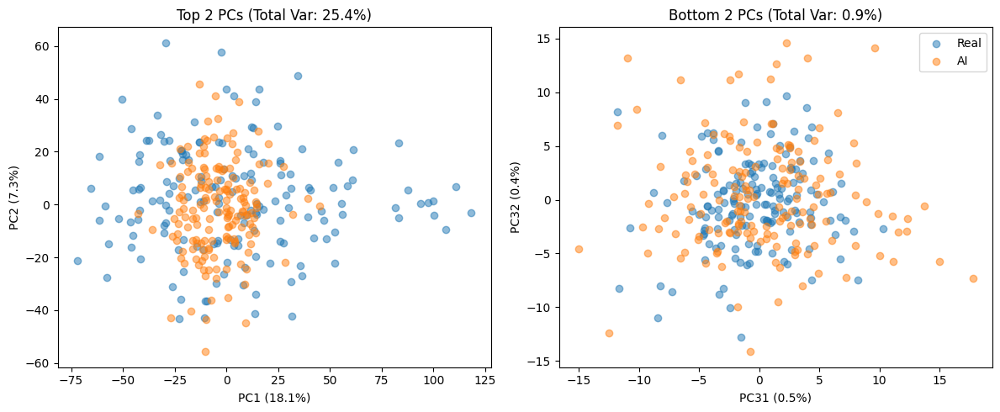

100%|██████████| 162/162 [00:00<00:00, 251.62it/s]


(162, 256, 256) (162, 256, 256)


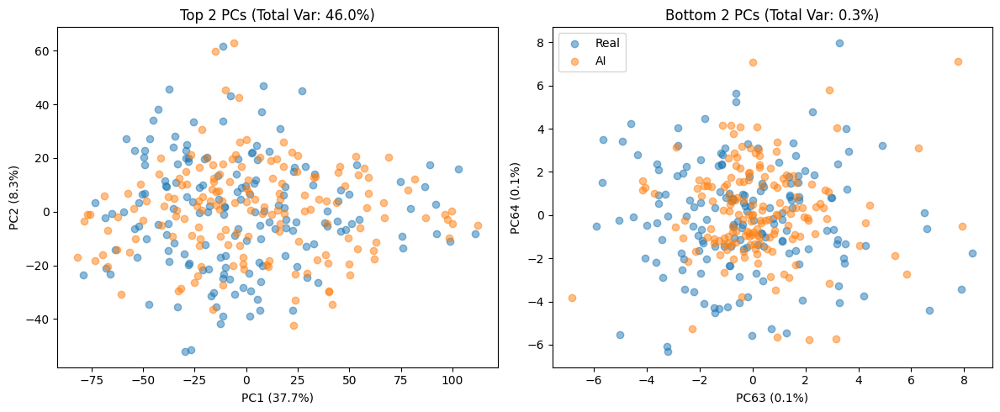

100%|██████████| 162/162 [00:00<00:00, 284.46it/s]


(162, 256, 256) (162, 256, 256)


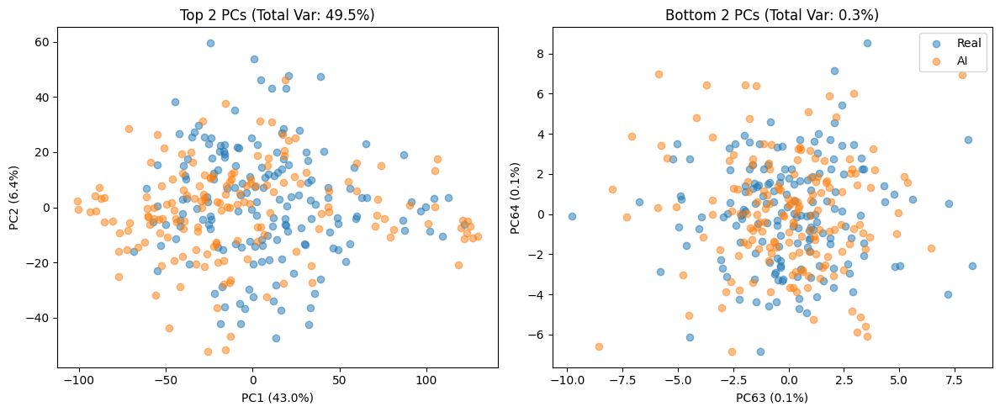

100%|██████████| 162/162 [00:00<00:00, 286.09it/s]


(162, 256, 256) (162, 256, 256)


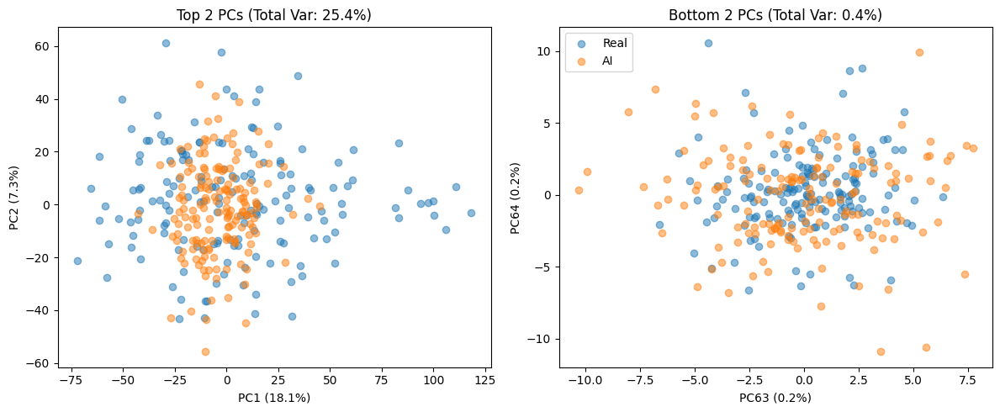

100%|██████████| 162/162 [00:01<00:00, 91.64it/s]


(162, 256, 256) (162, 256, 256)


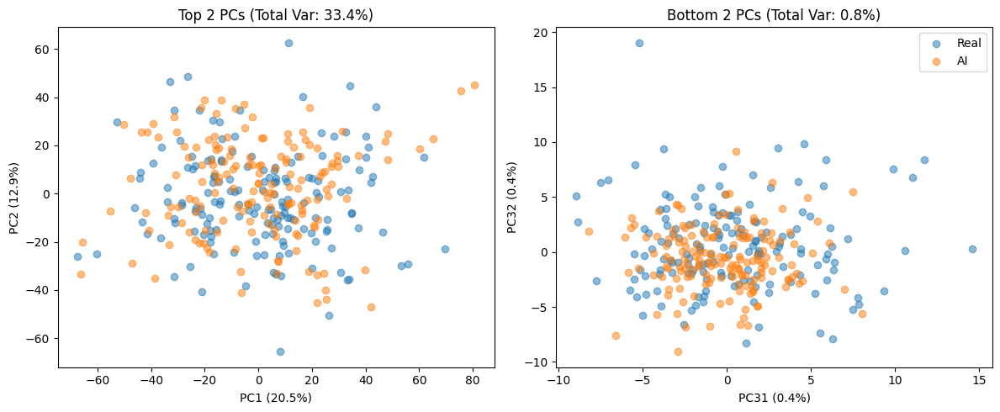

100%|██████████| 162/162 [00:00<00:00, 257.84it/s]


(162, 256, 256) (162, 256, 256)


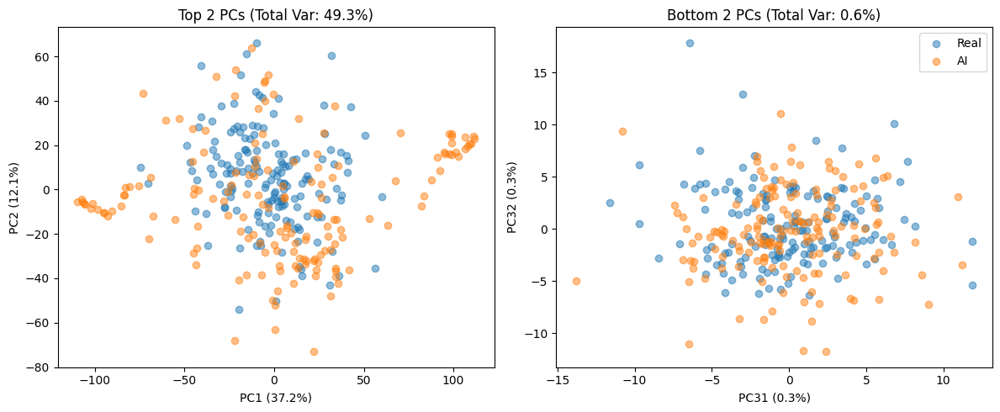

100%|██████████| 162/162 [00:00<00:00, 264.65it/s]


(162, 256, 256) (162, 256, 256)


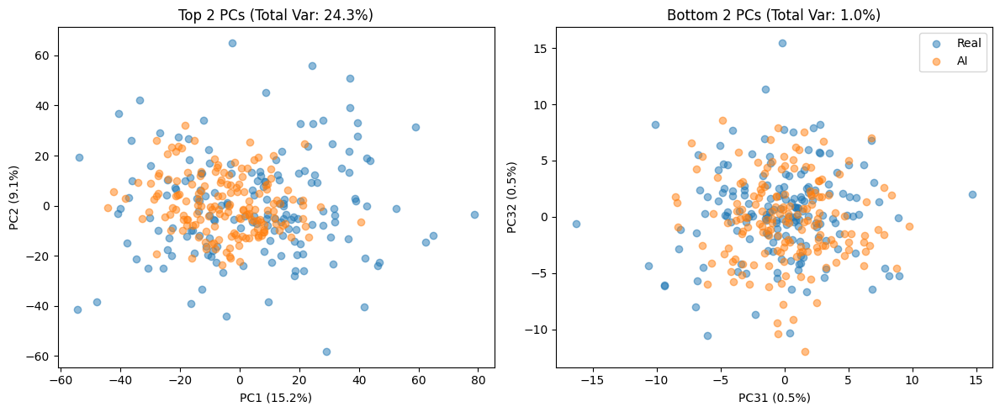

100%|██████████| 162/162 [00:00<00:00, 266.68it/s]


(162, 256, 256) (162, 256, 256)


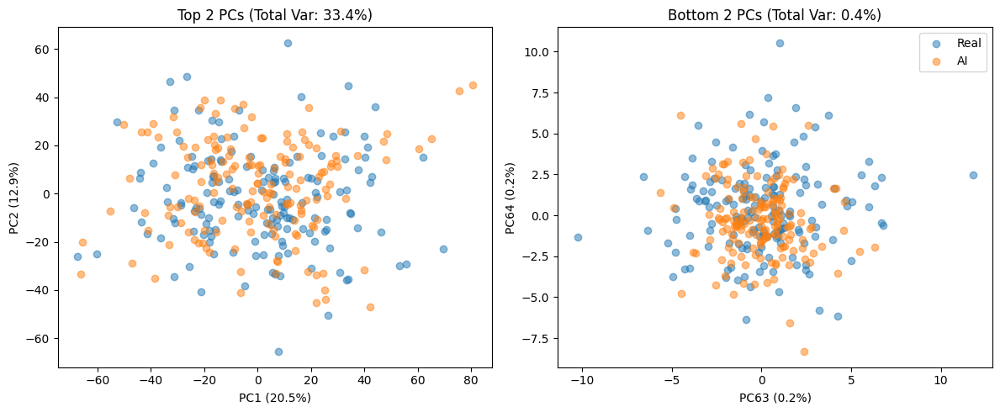

100%|██████████| 162/162 [00:00<00:00, 253.53it/s]


(162, 256, 256) (162, 256, 256)


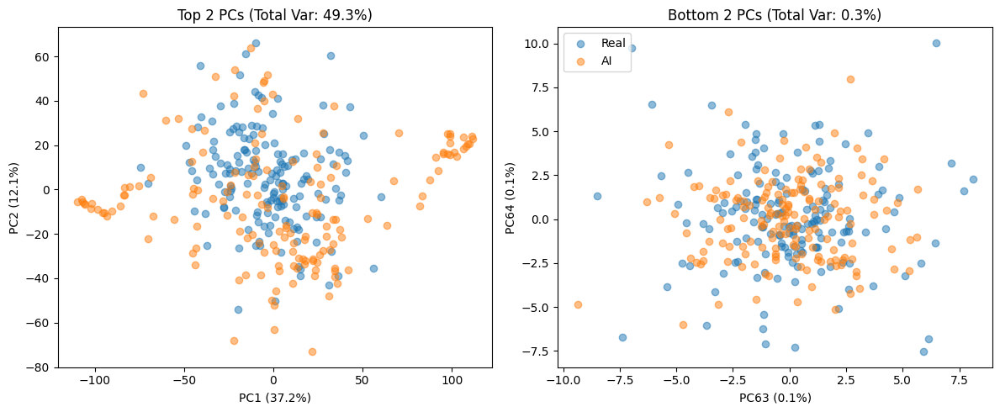

100%|██████████| 162/162 [00:00<00:00, 254.43it/s]


(162, 256, 256) (162, 256, 256)


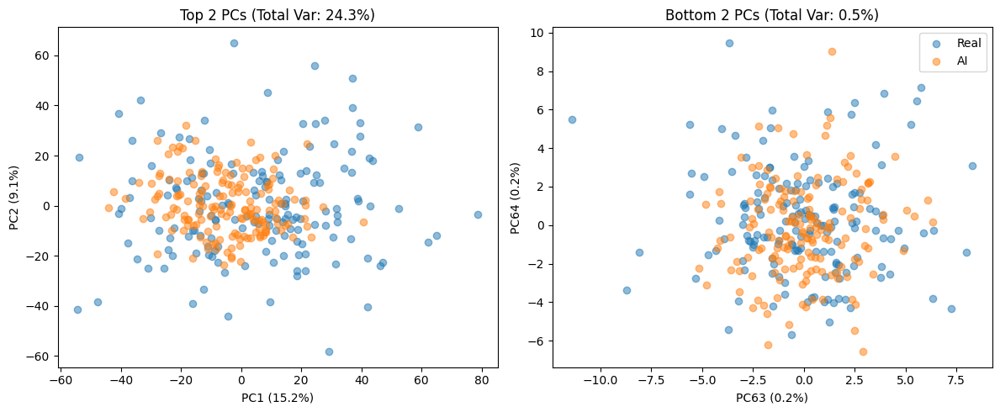

100%|██████████| 162/162 [00:01<00:00, 97.62it/s]


(162, 256, 256) (162, 256, 256)


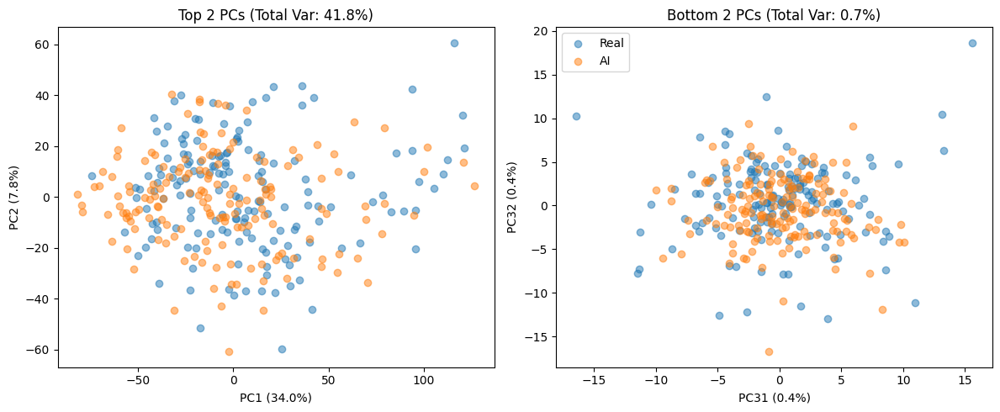

100%|██████████| 162/162 [00:00<00:00, 263.43it/s]


(162, 256, 256) (162, 256, 256)


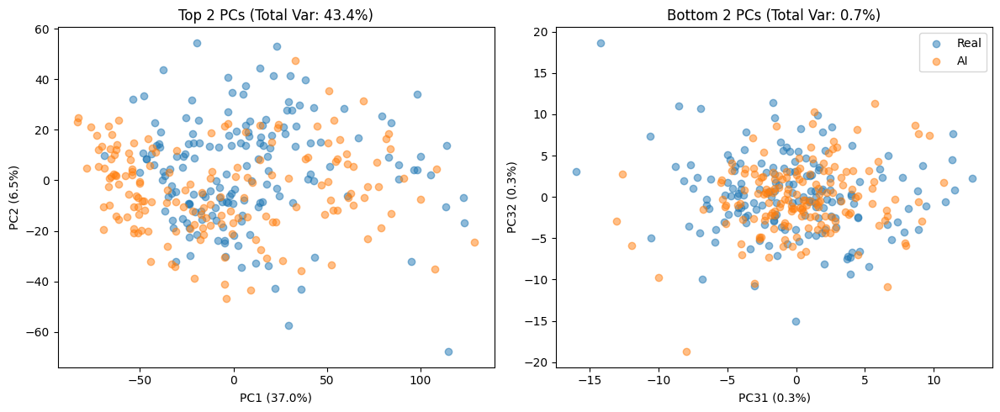

100%|██████████| 162/162 [00:00<00:00, 269.67it/s]


(162, 256, 256) (162, 256, 256)


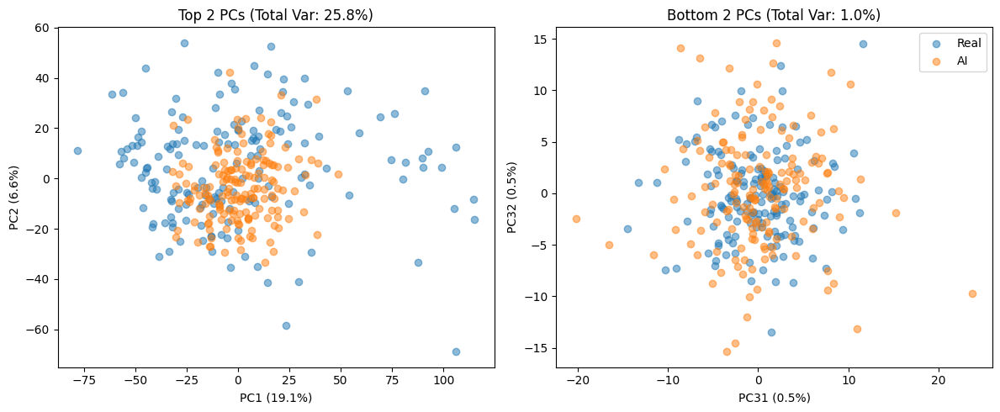

100%|██████████| 162/162 [00:00<00:00, 277.00it/s]


(162, 256, 256) (162, 256, 256)


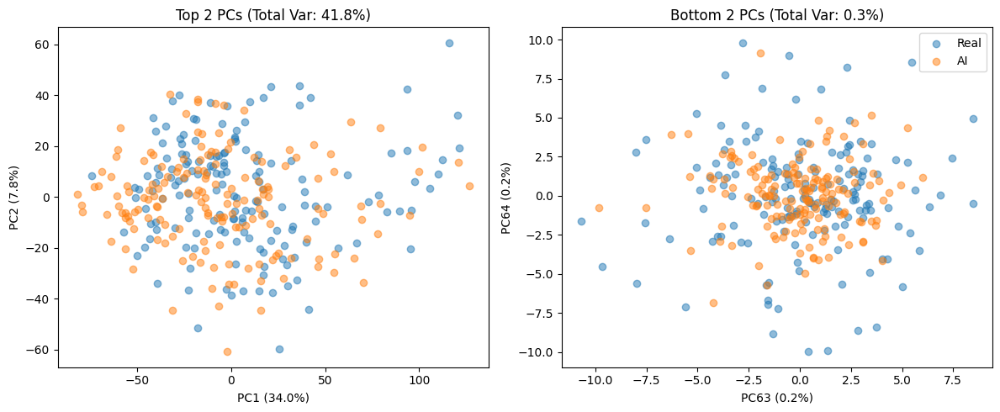

100%|██████████| 162/162 [00:00<00:00, 289.60it/s]


(162, 256, 256) (162, 256, 256)


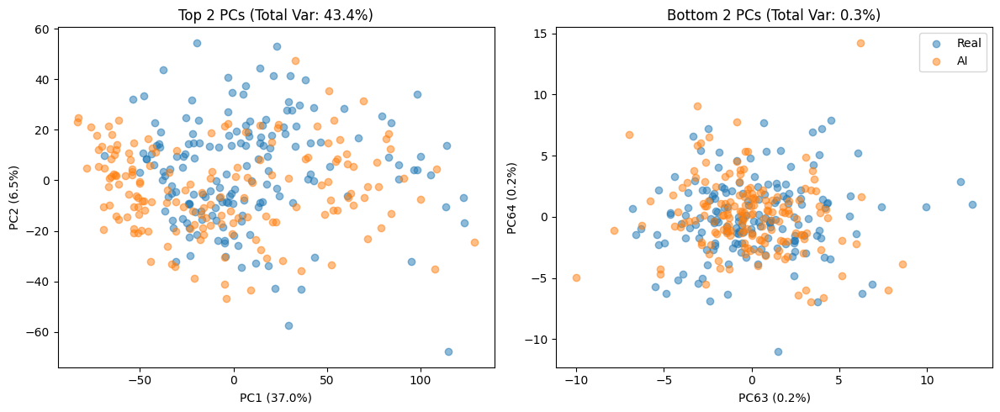

100%|██████████| 162/162 [00:00<00:00, 294.81it/s]


(162, 256, 256) (162, 256, 256)


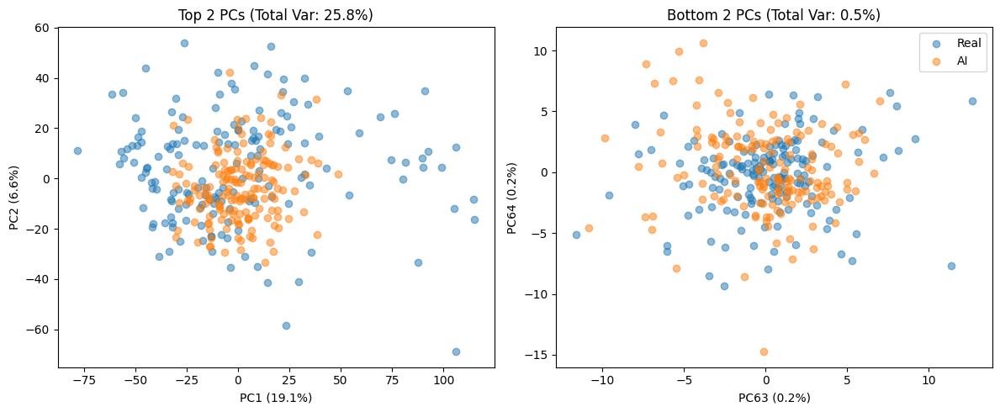

100%|██████████| 162/162 [00:01<00:00, 94.83it/s]


(162, 256, 256) (162, 256, 256)


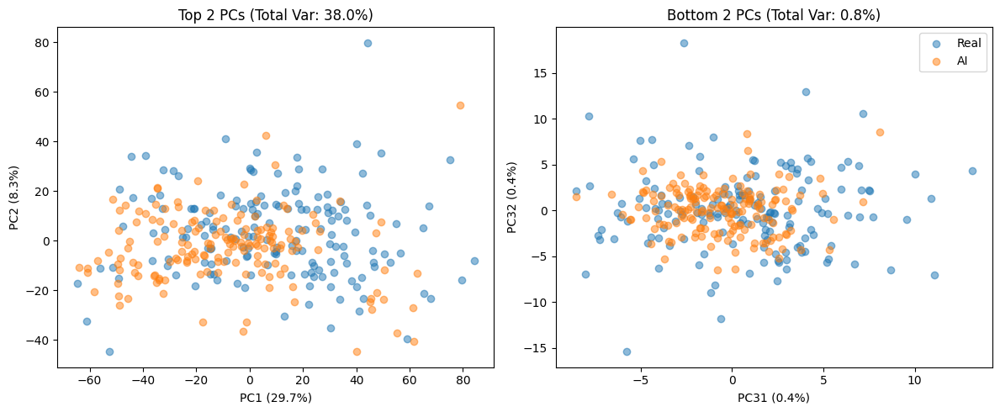

100%|██████████| 162/162 [00:00<00:00, 214.76it/s]


(162, 256, 256) (162, 256, 256)


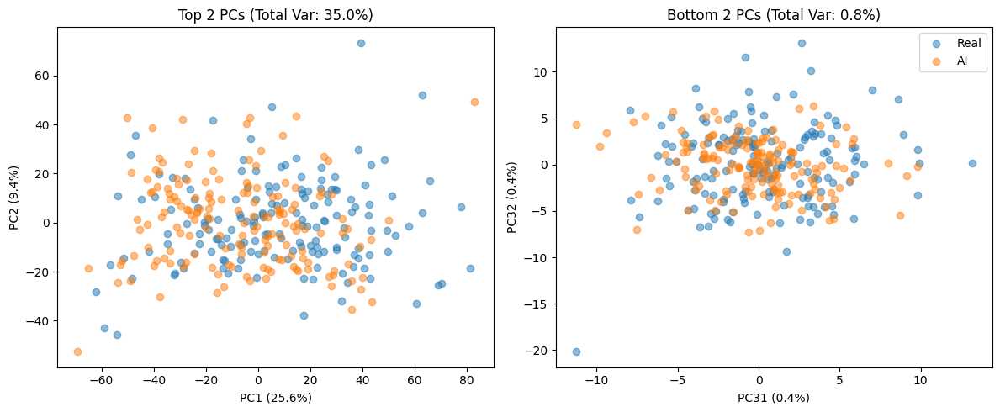

100%|██████████| 162/162 [00:00<00:00, 218.78it/s]


(162, 256, 256) (162, 256, 256)


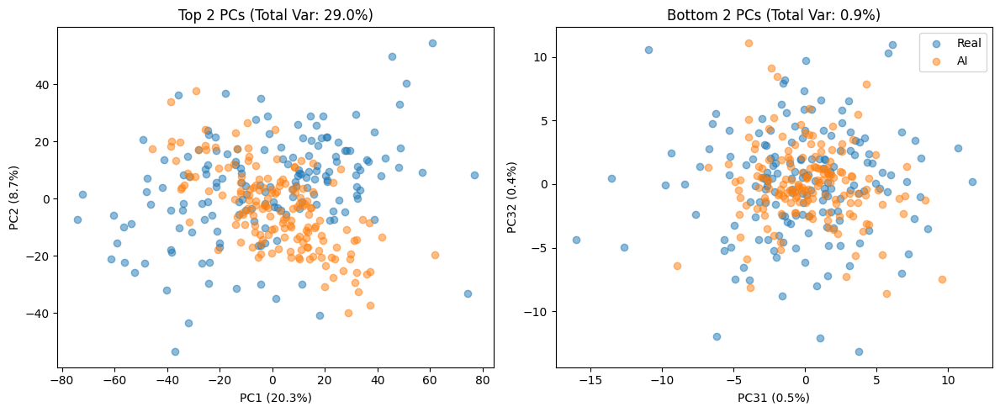

100%|██████████| 162/162 [00:00<00:00, 208.25it/s]


(162, 256, 256) (162, 256, 256)


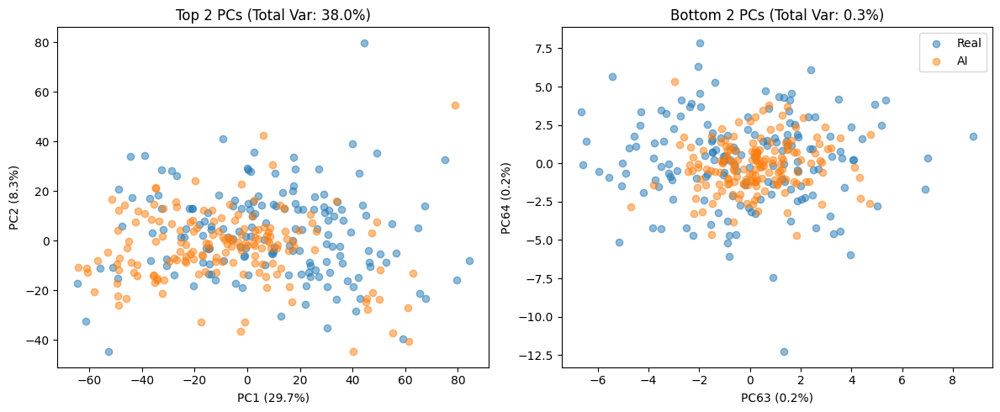

100%|██████████| 162/162 [00:00<00:00, 219.06it/s]


(162, 256, 256) (162, 256, 256)


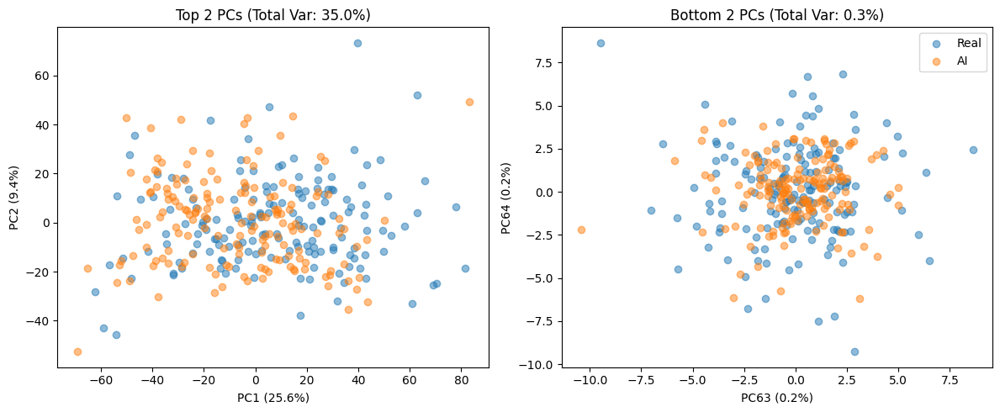

100%|██████████| 162/162 [00:00<00:00, 226.15it/s]


(162, 256, 256) (162, 256, 256)


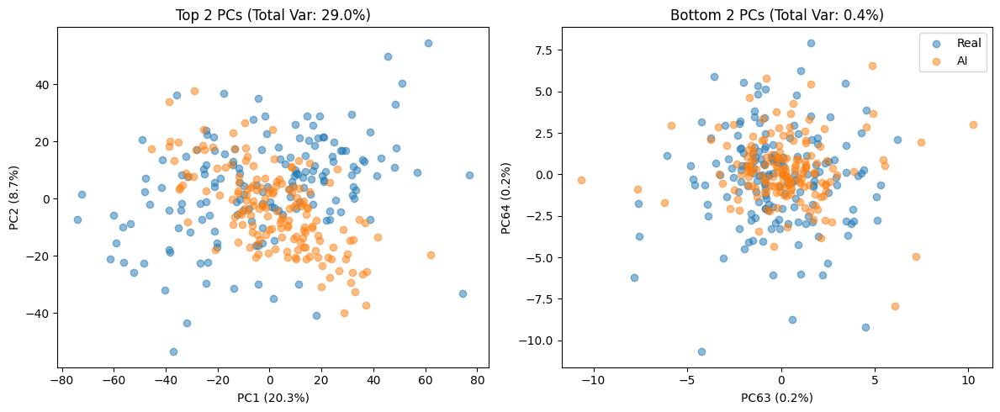

100%|██████████| 162/162 [00:01<00:00, 101.98it/s]


(162, 256, 256) (162, 256, 256)


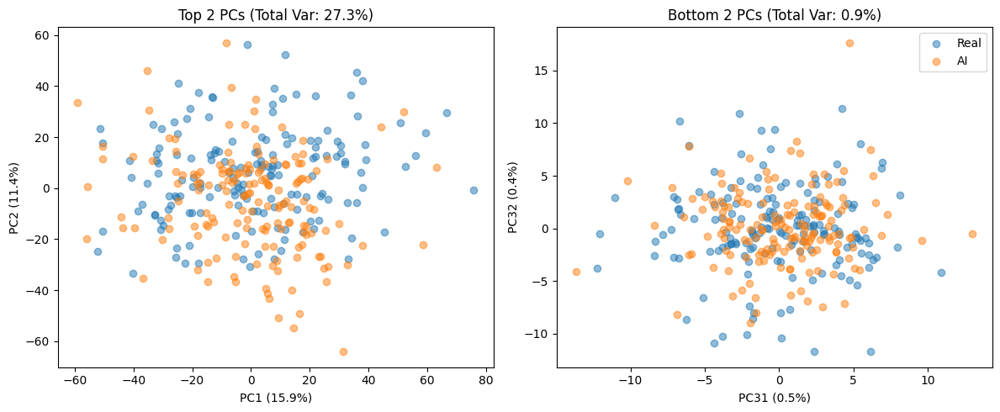

100%|██████████| 162/162 [00:00<00:00, 321.79it/s]


(162, 256, 256) (162, 256, 256)


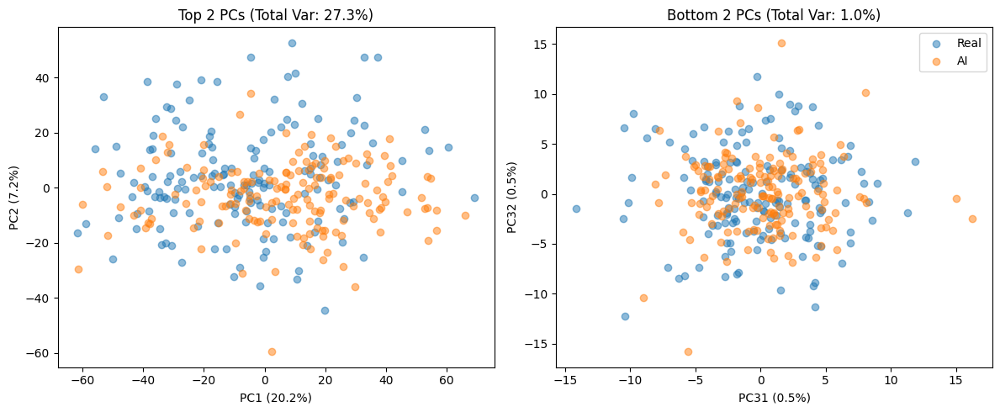

100%|██████████| 162/162 [00:00<00:00, 275.91it/s]


(162, 256, 256) (162, 256, 256)


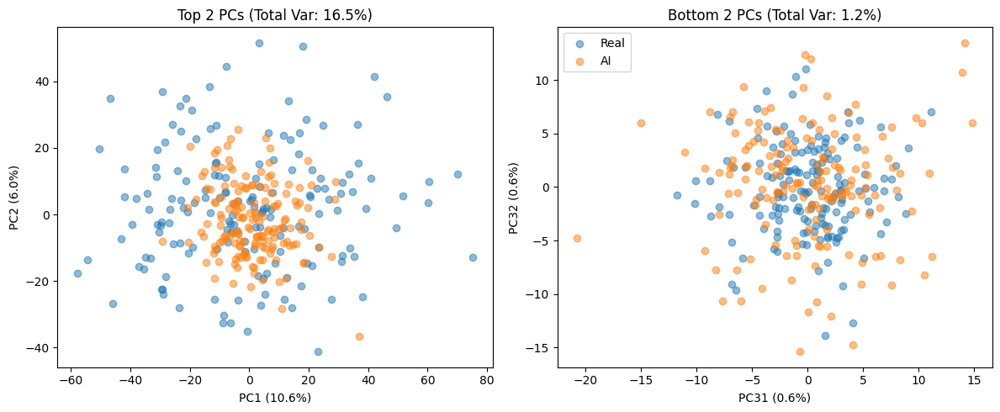

100%|██████████| 162/162 [00:00<00:00, 349.53it/s]


(162, 256, 256) (162, 256, 256)


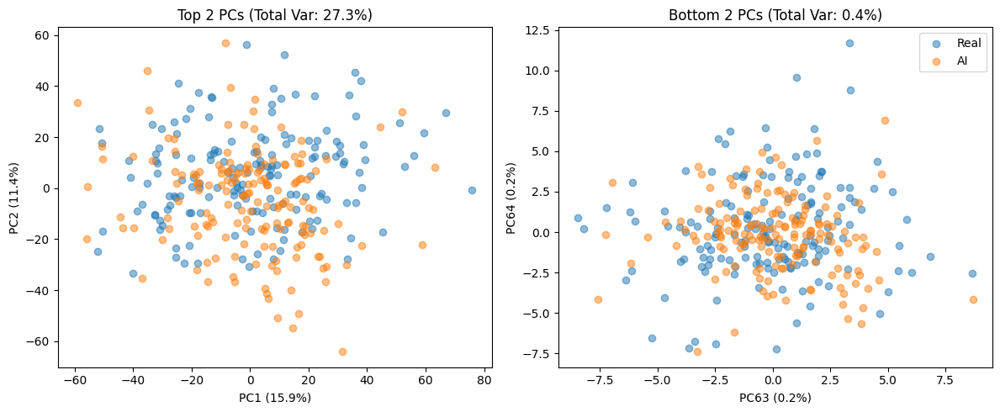

100%|██████████| 162/162 [00:00<00:00, 356.05it/s]


(162, 256, 256) (162, 256, 256)


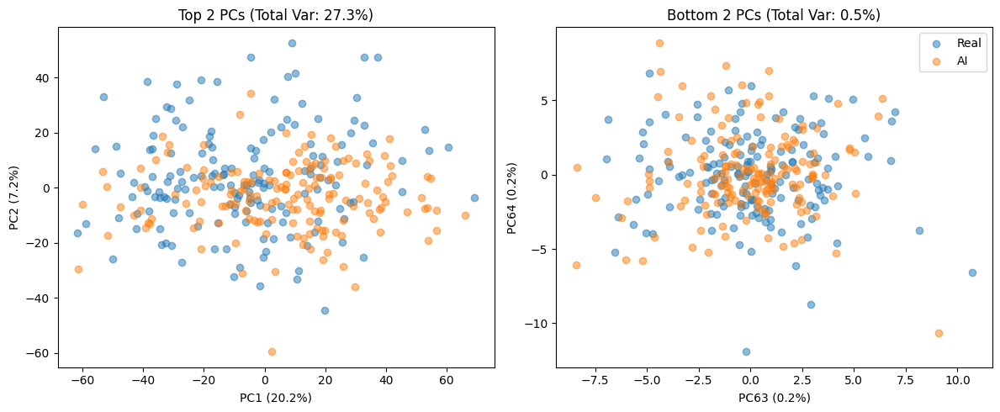

100%|██████████| 162/162 [00:00<00:00, 277.45it/s]


(162, 256, 256) (162, 256, 256)


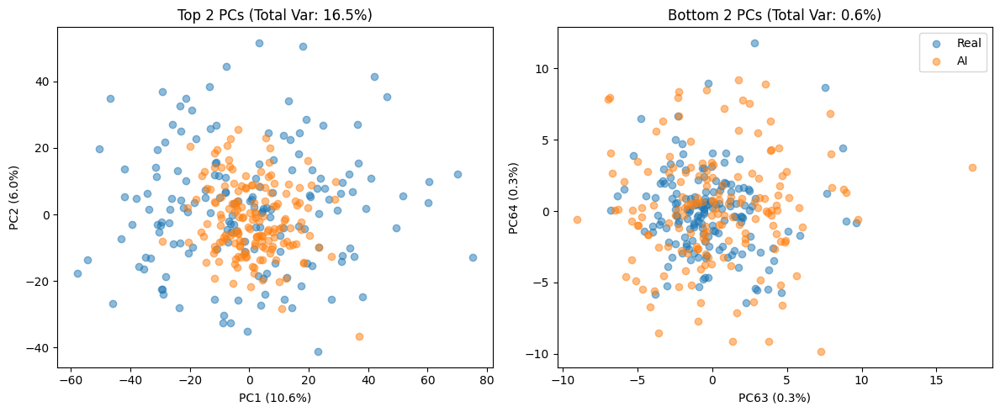

In [ ]:
for i in range(10):
    for dim in [32,64]:
        p1, p1r = pca_transform(f"../Data/GenImage/{classes_idx[i]}/bgan", f"../Data/GenImage/{classes_idx[i]}/nature", f"../Data/PCA/original/{classes_idx[i]}_bgan_{dim}.png", dim)
        p2, p2r = pca_transform(f"../Data/GenImage/{classes_idx[i]}/midj", f"../Data/GenImage/{classes_idx[i]}/nature", f"../Data/PCA/original/{classes_idx[i]}_midj_{dim}.png", dim)
        p3, p3r = pca_transform(f"../Data/GenImage/{classes_idx[i]}/sd_15", f"../Data/GenImage/{classes_idx[i]}/nature", f"../Data/PCA/original/{classes_idx[i]}_sd_15_{dim}.png", dim)

In [ ]:
# p1,p1r = pca_transform("../Data/GenImage/adm", "../Data/GenImage/nature", "../Data/PCA/adm_32.png", 32)
# p2,p2r = pca_transform("../Data/GenImage/bgan", "../Data/GenImage/nature", "../Data/PCA/bgan_32.png", 32)
# p3,p3r = pca_transform("../Data/GenImage/glide", "../Data/GenImage/nature", "../Data/PCA/glide_32.png", 32)
# p4,p4r = pca_transform("../Data/GenImage/midj", "../Data/GenImage/nature", "../Data/PCA/midj_32.png", 32)
# p5,p5r = pca_transform("../Data/GenImage/sd_14", "../Data/GenImage/nature", "../Data/PCA/sd_14_32.png", 32)

## Features

In [9]:
import clip
from transformers import AutoImageProcessor, AutoModel, AutoProcessor, AutoModelForImageClassification

In [4]:
device = "cuda" if torch.cuda.is_available() else "cpu"
SRC_PATH = "../Data/GenImage/"

In [5]:
generator_names = ["adm","bgan","glide","midj","sd_14","sd_15","vqdm","wukong"]

### CLIP

In [13]:
model, preprocess = clip.load("ViT-B/32", device=device)

In [ ]:
# input_dir = Path(SRC_PATH + "glide")
# image_paths = list(input_dir.glob("*")) 
# print(f"Found {len(image_paths)} pictures.")

# dataset = ImageFolderDataset(image_paths, transform=preprocess)
# dataloader = DataLoader(dataset, batch_size=64, shuffle=False, collate_fn=collate_fn)

# save_path = "../Data/Features/clip/"
# os.makedirs(save_path,exist_ok = True)
# all_features, all_paths = [], []
# with torch.no_grad():
#     for images, paths in tqdm(dataloader, desc="Image Encoding"):
#         if images is None: continue
#         images = images.to(device)
#         feats = model.encode_image(images).cpu()
#         all_features.append(feats)
#         all_paths.extend(paths)


# all_features = torch.cat(all_features)
# torch.save({"features": all_features, "paths": all_paths}, save_path + "glide_image_features.pt")

Found 1000 pictures.


In [14]:
class ImageFolderDataset(Dataset):
    def __init__(self, image_paths, transform):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        path = self.image_paths[idx]
        try:
            image = Image.open(path).convert("RGB")
            image = self.transform(image)
            return image, str(path)
        except:
            print("Failure open image.")
            return None  


def collate_fn(batch):
    batch = [item for item in batch if item is not None]
    if not batch:
        return None, None
    images, paths = zip(*batch)
    return torch.stack(images), paths

In [ ]:
def clip_encode(global_name,model, transform, collate_fn, save_path = "../Data/Features/clip/", batch_size = 64):
    input_dir = Path(SRC_PATH + global_name)
    image_paths = list(input_dir.glob("*")) 
    print(f"Found {len(image_paths)} pictures.")
    dataset = ImageFolderDataset(image_paths, transform=transform)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
    os.makedirs(save_path,exist_ok = True)
    all_features, all_paths = [], []
    with torch.no_grad():
        for images, paths in tqdm(dataloader, desc="Image Encoding"):
            if images is None: continue
            images = images.to(device)
            feats = model.encode_image(images).cpu()
            all_features.append(feats)
            all_paths.extend(paths)
    all_features = torch.cat(all_features)
    print(all_features.shape)
    torch.save({"features": all_features, "paths": all_paths}, save_path + global_name + "_image_features.pt")
    return all_features

def clip_encode_2(input_dir, model, transform, collate_fn, save_path, batch_size = 64):
    input_dir = Path(input_dir)
    output_path = Path(save_path)
    output_path.parent.mkdir(parents=True,exist_ok=True)
    image_paths = list(input_dir.glob("*")) 
    print(f"Found {len(image_paths)} pictures.")
    dataset = ImageFolderDataset(image_paths, transform=transform)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
    # os.makedirs(save_path,exist_ok = True)
    all_features, all_paths = [], []
    with torch.no_grad():
        for images, paths in tqdm(dataloader, desc="Image Encoding"):
            if images is None: continue
            images = images.to(device)
            feats = model.encode_image(images).cpu()
            all_features.append(feats)
            all_paths.extend(paths)
    all_features = torch.cat(all_features)
    print(all_features.shape)
    torch.save({"features": all_features, "paths": all_paths}, save_path)
    return all_features

In [18]:
for i in range(10):
    _ = clip_encode_2(SRC_PATH + classes_idx[i] + "/bgan", model, preprocess, collate_fn, f"../Data/Features/clip/{classes_idx[i]}/bgan.pt")
    _ = clip_encode_2(SRC_PATH + classes_idx[i] + "/midj", model, preprocess, collate_fn, f"../Data/Features/clip/{classes_idx[i]}/midj.pt")
    _ = clip_encode_2(SRC_PATH + classes_idx[i] + "/sd_15", model, preprocess, collate_fn, f"../Data/Features/clip/{classes_idx[i]}/sd_15.pt")
    _ = clip_encode_2(SRC_PATH + classes_idx[i] + "/nature", model, preprocess, collate_fn, f"../Data/Features/clip/{classes_idx[i]}/nature.pt")

Found 162 pictures.


Image Encoding:   0%|          | 0/3 [00:00<?, ?it/s]

d:\IPTP\Stage 3A\Stage\Code\.venv\lib\site-packages\torch\nn\functional.py:5560: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:555.)
  attn_output = scaled_dot_product_attention(q, k, v, attn_mask, dropout_p, is_causal)
Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  2.30it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:05<00:00,  1.82s/it]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  1.50it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  2.18it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:05<00:00,  1.93s/it]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.48it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  2.90it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:00<00:00,  5.72it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:05<00:00,  1.98s/it]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  1.52it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  2.35it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:00<00:00,  5.65it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:05<00:00,  1.95s/it]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.44it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:00<00:00,  3.17it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:00<00:00,  5.63it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:06<00:00,  2.01s/it]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  1.73it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  2.92it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:00<00:00,  5.64it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:05<00:00,  1.85s/it]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  1.51it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:00<00:00,  3.02it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:00<00:00,  5.57it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:05<00:00,  1.92s/it]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  1.52it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  2.99it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:00<00:00,  5.52it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:05<00:00,  1.78s/it]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.49it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  2.84it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:00<00:00,  5.68it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:06<00:00,  2.11s/it]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  1.55it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:01<00:00,  2.43it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:00<00:00,  5.19it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:06<00:00,  2.15s/it]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.42it/s]


torch.Size([162, 512])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:00<00:00,  3.36it/s]

torch.Size([162, 512])


In [ ]:
# clip_encode("adm",model,preprocess, collate_fn)
# clip_encode("bgan",model,preprocess, collate_fn)
# midj_ai = clip_encode("midj", model, preprocess, collate_fn)
# sd_14_ai = clip_encode("sd_14", model, preprocess, collate_fn)
# nature_clip = clip_encode("nature", model, preprocess, collate_fn)

Found 1000 pictures.


Image Encoding: 100%|██████████| 16/16 [00:12<00:00,  1.24it/s]


### DinoV2

In [19]:
processor = AutoImageProcessor.from_pretrained("facebook/dinov2-base")
model = AutoModel.from_pretrained("facebook/dinov2-base").to(device)

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


In [20]:
class ImageFolderDataset(Dataset):
    def __init__(self, image_paths):
        self.image_paths = image_paths

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        path = self.image_paths[idx]
        try:
            image = Image.open(path).convert("RGB")
            return image, str(path)
        except Exception as e:
            print(f"Failure open image because of {e}")
            return None


def collate_fn(batch):
    batch = [item for item in batch if item is not None]
    if not batch:
        return None, None
    images, paths = zip(*batch)
    return list(images), paths

In [21]:
def dinov2_encode(global_name,model, transform, collate_fn, save_path = "../Data/Features/dinov2/", batch_size = 64):
    input_dir = Path(SRC_PATH + global_name)
    image_paths = list(input_dir.glob("*")) 
    print(f"Found {len(image_paths)} pictures.")
    dataset = ImageFolderDataset(image_paths)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
    os.makedirs(save_path,exist_ok = True)
    all_features, all_paths = [], []
    with torch.no_grad():
        for images, paths in tqdm(dataloader, desc="Image Encoding"):
            if images is None: continue
            # processor expects a list of PIL images
            inputs = transform(images=images, return_tensors="pt").to(device)
            outputs = model(**inputs)
            feats = outputs.last_hidden_state.mean(dim=1).cpu()
            all_features.append(feats)
            all_paths.extend(paths)
    all_features = torch.cat(all_features)
    print(all_features.shape)
    torch.save({"features": all_features, "paths": all_paths}, save_path + global_name + "_image_features.pt")
    return all_features

def dinov2_encode_2(input_dir, model, transform, collate_fn, save_path, batch_size = 64):
    input_dir = Path(input_dir)
    output_path = Path(save_path)
    output_path.parent.mkdir(parents=True,exist_ok=True)
    image_paths = list(input_dir.glob("*")) 
    print(f"Found {len(image_paths)} pictures.")
    dataset = ImageFolderDataset(image_paths)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
    # os.makedirs(save_path,exist_ok = True)
    all_features, all_paths = [], []
    with torch.no_grad():
        for images, paths in tqdm(dataloader, desc="Image Encoding"):
            if images is None: continue
            # processor expects a list of PIL images
            inputs = transform(images=images, return_tensors="pt").to(device)
            outputs = model(**inputs)
            feats = outputs.last_hidden_state.mean(dim=1).cpu()
            all_features.append(feats)
            all_paths.extend(paths)
    all_features = torch.cat(all_features)
    print(all_features.shape)
    torch.save({"features": all_features, "paths": all_paths}, save_path)
    return all_features

In [22]:
for i in range(10):
    _ = dinov2_encode_2(SRC_PATH + classes_idx[i] + "/bgan", model, processor, collate_fn, f"../Data/Features/dinov2/{classes_idx[i]}/bgan.pt")
    _ = dinov2_encode_2(SRC_PATH + classes_idx[i] + "/midj", model, processor, collate_fn, f"../Data/Features/dinov2/{classes_idx[i]}/midj.pt")
    _ = dinov2_encode_2(SRC_PATH + classes_idx[i] + "/sd_15", model, processor, collate_fn, f"../Data/Features/dinov2/{classes_idx[i]}/sd_15.pt")
    _ = dinov2_encode_2(SRC_PATH + classes_idx[i] + "/nature", model, processor, collate_fn, f"../Data/Features/dinov2/{classes_idx[i]}/nature.pt")

Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.16it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:08<00:00,  2.74s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.32s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.12s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.27it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:08<00:00,  2.68s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.29s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.02it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:08<00:00,  2.70s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.29s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.09s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.27it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:08<00:00,  2.79s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.31s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.01s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.26it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:08<00:00,  2.87s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.24s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.02s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.24it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:07<00:00,  2.58s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.30s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.03it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.27it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:07<00:00,  2.57s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.23s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.05it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.30it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:07<00:00,  2.42s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.21s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.04it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:08<00:00,  2.76s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.28s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.07s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:02<00:00,  1.24it/s]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:08<00:00,  2.89s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:04<00:00,  1.37s/it]


torch.Size([162, 768])
Found 162 pictures.


Image Encoding: 100%|██████████| 3/3 [00:03<00:00,  1.02s/it]

torch.Size([162, 768])


In [ ]:
# glide_dino = dinov2_encode("glide",model, processor, collate_fn)
# adm_dino = dinov2_encode("adm",model, processor, collate_fn)
# bgan_dino = dinov2_encode("bgan",model, processor, collate_fn)
# midj_dino = dinov2_encode("midj",model, processor, collate_fn)
# sd_14_dino = dinov2_encode("sd_14",model, processor, collate_fn)
# nature_dino = dinov2_encode("nature",model, processor, collate_fn)

Found 1000 pictures.


Image Encoding: 100%|██████████| 16/16 [00:15<00:00,  1.02it/s]


## PCA after Encoding

In [12]:
def pca_transform_tensor(tensor_nature,tensor_ai, output_path, n_components = 64, size = 256, max_samples = 1000, grey = True):
    tensor = torch.cat([tensor_nature, tensor_ai], dim=0)
    tensor = tensor.flatten(start_dim = 1)
    tensor_np = tensor.numpy()
    labels = np.array([1]*len(tensor_nature) + [0]*len(tensor_ai))
    pca = PCA(n_components)
    pca_result = pca.fit_transform(tensor_np)
    plot_pca_components(pca_result, labels, pca.explained_variance_ratio_, output_path)

    return pca, pca_result

C:\Users\X-tyw\AppData\Local\Temp\ipykernel_3444\2376246178.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 5))


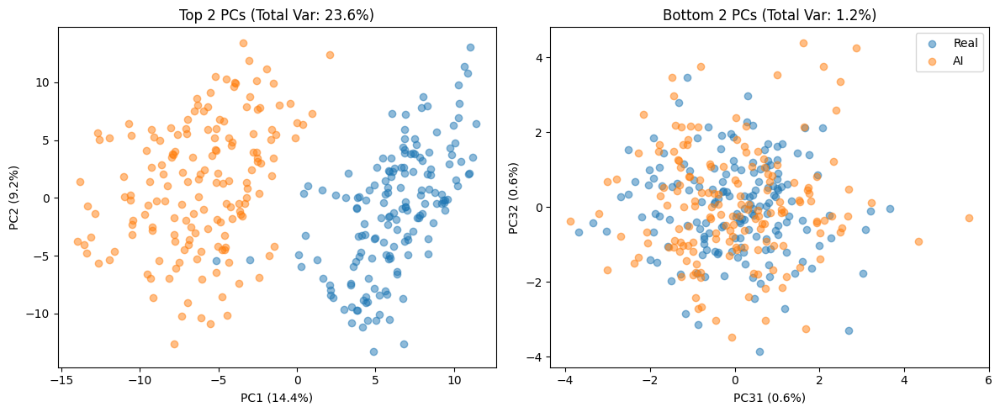

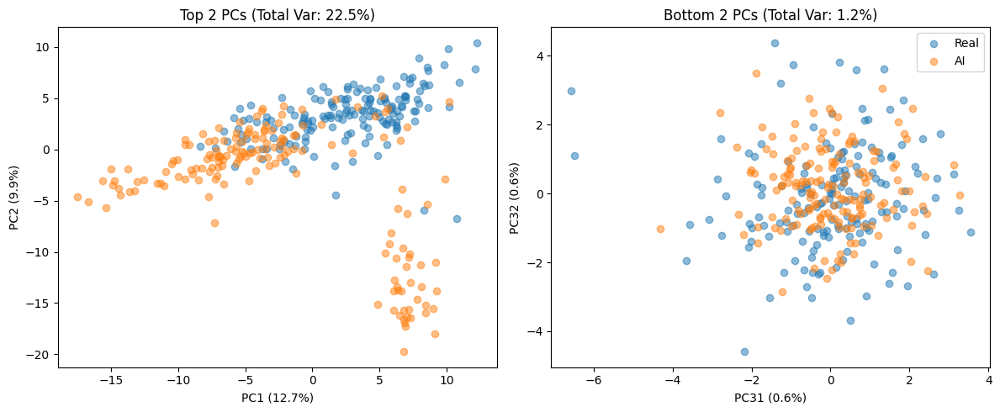

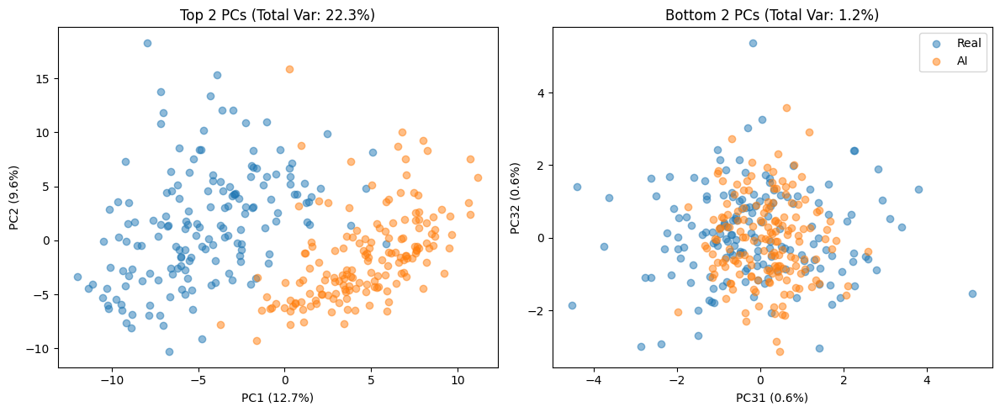

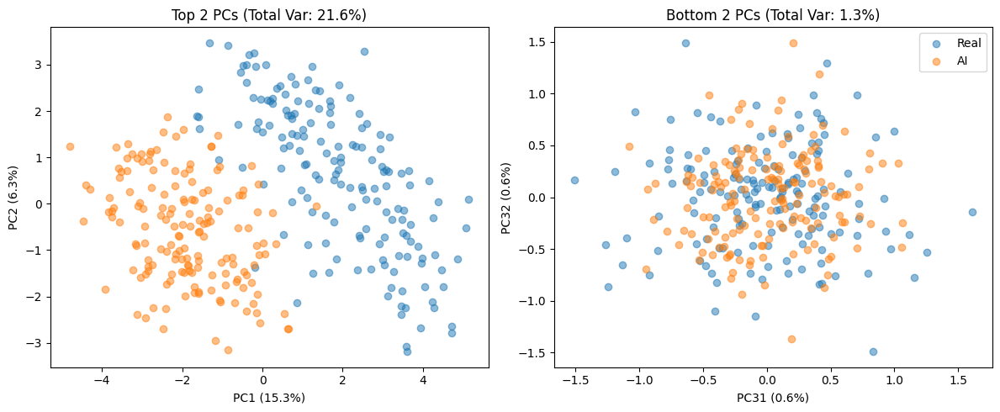

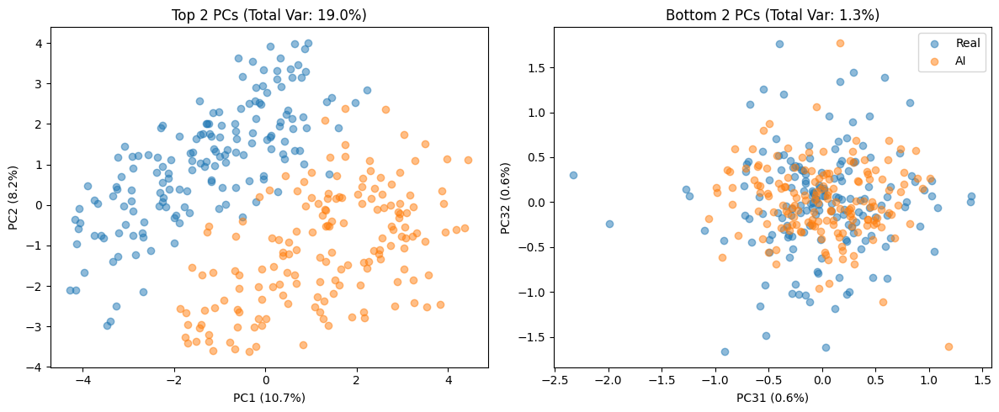

...

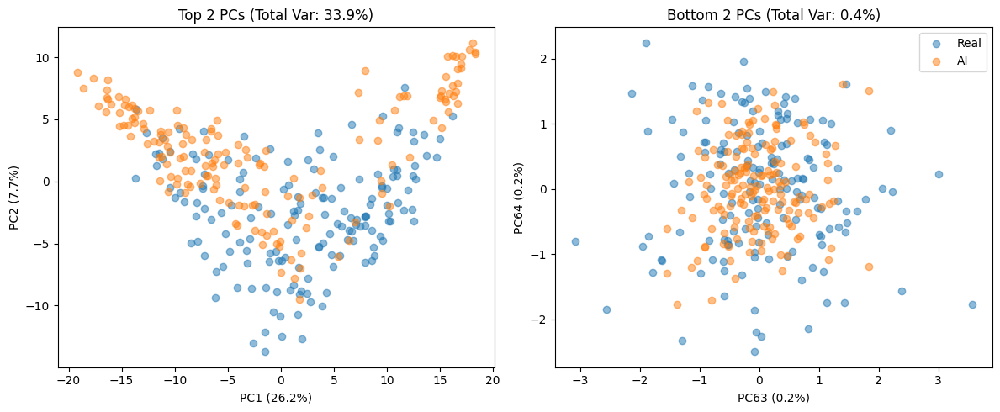

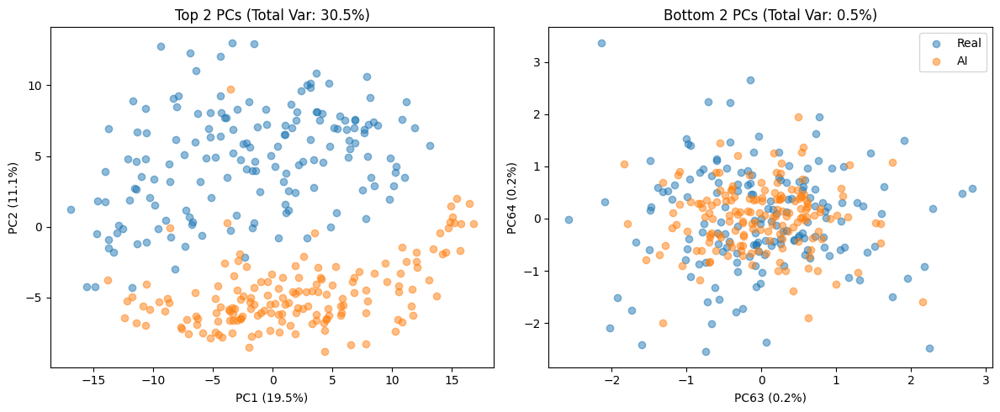

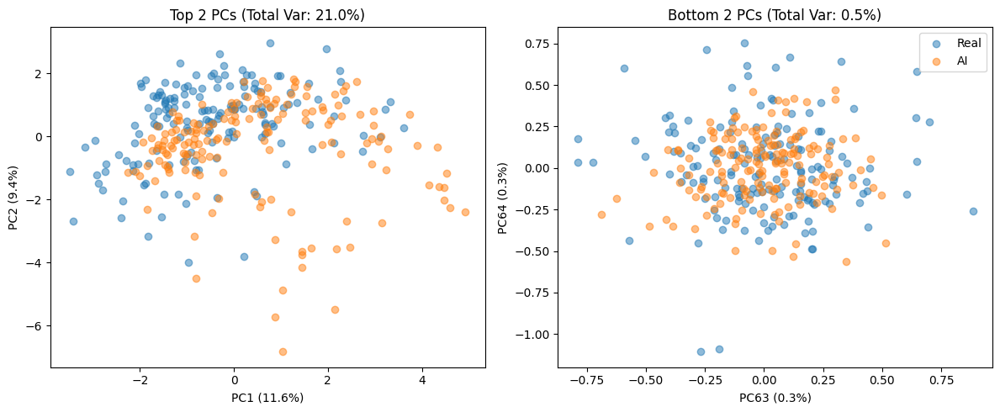

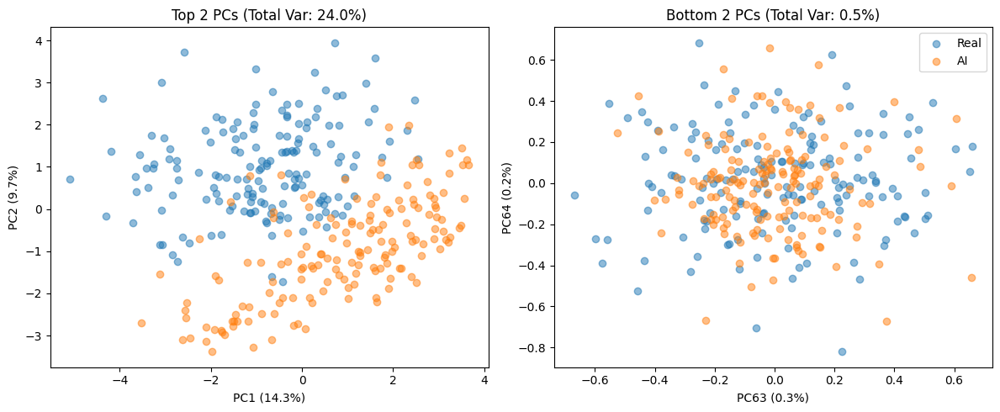

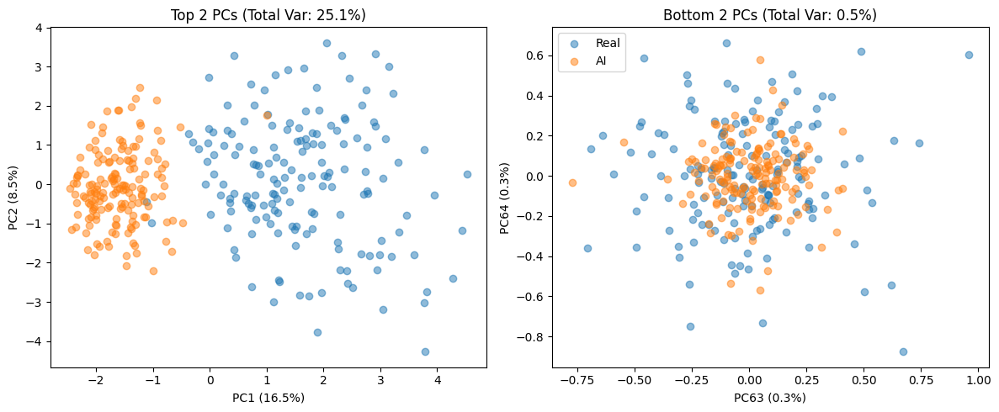

In [13]:
for i in range(10):
    bgan_dino = torch.load(f"../Data/Features/dinov2/{classes_idx[i]}/bgan.pt", weights_only=True)["features"]
    midj_dino = torch.load(f"../Data/Features/dinov2/{classes_idx[i]}/midj.pt", weights_only=True)["features"]
    sd_15_dino = torch.load(f"../Data/Features/dinov2/{classes_idx[i]}/sd_15.pt", weights_only=True)["features"]
    nature_dino = torch.load(f"../Data/Features/dinov2/{classes_idx[i]}/nature.pt", weights_only=True)["features"]
    bgan_clip = torch.load(f"../Data/Features/clip/{classes_idx[i]}/bgan.pt", weights_only=True)["features"]
    midj_clip = torch.load(f"../Data/Features/clip/{classes_idx[i]}/midj.pt", weights_only=True)["features"]
    sd_15_clip = torch.load(f"../Data/Features/clip/{classes_idx[i]}/sd_15.pt", weights_only=True)["features"]
    nature_clip = torch.load(f"../Data/Features/clip/{classes_idx[i]}/nature.pt", weights_only=True)["features"]

    for dim in [32,64]:
        _, _ = pca_transform_tensor(nature_dino,bgan_dino, f"../Data/PCA/dino/{classes_idx[i]}_bgan_{dim}.png", dim)
        _, _ = pca_transform_tensor(nature_dino,midj_dino, f"../Data/PCA/dino/{classes_idx[i]}_midj_{dim}.png", dim)
        _, _ = pca_transform_tensor(nature_dino,sd_15_dino, f"../Data/PCA/dino/{classes_idx[i]}_sd_15_{dim}.png", dim)
        _, _ = pca_transform_tensor(nature_clip,bgan_clip, f"../Data/PCA/clip/{classes_idx[i]}_bgan_{dim}.png", dim)
        _, _ = pca_transform_tensor(nature_clip,midj_clip, f"../Data/PCA/clip/{classes_idx[i]}_midj_{dim}.png", dim)
        _, _ = pca_transform_tensor(nature_clip,sd_15_clip, f"../Data/PCA/clip/{classes_idx[i]}_sd_15_{dim}.png", dim)


## MMD & W2 distance

In [ ]:
import torch
import numpy as np
from sklearn.covariance import LedoitWolf  
from tqdm import tqdm
from scipy.spatial.distance import mahalanobis
import pandas as pd
import ot


In [ ]:
def precalcul(pooled, X_real):
    X_real = X_real.float()

    cov = torch.cov(pooled.T)  # (n_features, n_features)
    Sigma_inv = torch.linalg.pinv(cov.float()).float()
    

    dist_sq = torch.cdist(X_real, X_real).square()
    gamma_rbf = 1.0 / (2 * torch.median(dist_sq[dist_sq > 0]))  
    sigma_lap = torch.median(torch.cdist(X_real, X_real, p=1))

    
    return Sigma_inv, gamma_rbf, sigma_lap


def rbf_kernel(X, Y, gamma=None):

    if gamma is None:
        dist = torch.cdist(X, X).square()
        gamma = 1.0 / (2 * torch.median(dist[dist > 0]))
    K_XY = torch.exp(-gamma * torch.cdist(X.float(), Y.float()).square())
    return K_XY

def laplacian_kernel(X, Y, sigma=None):
  
    if sigma is None:
        sigma = torch.median(torch.cdist(X.float(), X.float(), p=1))  
    K_XY = torch.exp(-torch.cdist(X.float(), Y.float(), p=1) / sigma)
    return K_XY

def mahalanobis_kernel(X, Y, Sigma_inv):
 
    diff = X[:, None] - Y  # (n_x, n_y, n_features)
    M = torch.einsum('ijk,kl,ijl->ij', diff.float(), Sigma_inv.float(), diff.float())  # (x-y)^T Sigma^{-1} (x-y)
    return torch.exp(-M)

def mixed_kernel(X, Y, gamma_rbf=None, sigma_lap=None, alpha=0.5):
    
    K_rbf = rbf_kernel(X, Y, gamma_rbf)
    K_lap = laplacian_kernel(X, Y, sigma_lap)
    return alpha * K_rbf + (1 - alpha) * K_lap



def compute_mmd(K_XX, K_YY, K_XY):
    
    n = K_XX.shape[0]
    m = K_YY.shape[0]
    # 去除对角线
    K_XX_sum = (K_XX.sum() - K_XX.diag().sum()) / (n * (n - 1))
    K_YY_sum = (K_YY.sum() - K_YY.diag().sum()) / (m * (m - 1))
    K_XY_mean = K_XY.mean()
    return K_XX_sum + K_YY_sum - 2 * K_XY_mean

def mmd_with_kernel(X, Y, kernel_fn, **kernel_kwargs):
    
    K_XX = kernel_fn(X, X, **kernel_kwargs)
    K_YY = kernel_fn(Y, Y, **kernel_kwargs)
    K_XY = kernel_fn(X, Y, **kernel_kwargs)
    return compute_mmd(K_XX, K_YY, K_XY)

def w2_distance_ot(X: torch.Tensor, Y: torch.Tensor):
    
    X = X.detach().cpu().numpy()
    Y = Y.detach().cpu().numpy()
    n = X.shape[0]
    m = Y.shape[0]
    
    
    a = np.ones(n) / n
    b = np.ones(m) / m
    
    
    M = ot.dist(X, Y, metric='euclidean') ** 2
    
    
    w2_squared = ot.emd2(a, b, M)
    return np.sqrt(w2_squared)


def evaluate_kernel(X, Y, kernel_fn, class_name=None, model_name=None, n_perm=500, **kernel_kwargs):
    X, Y = X.to(device), Y.to(device)
    mmd_obs = mmd_with_kernel(X, Y, kernel_fn, **kernel_kwargs)

    pooled = torch.cat([X, Y])
    null_dist = torch.zeros(n_perm, device='cuda')
    for i in range(n_perm):
        idx = torch.randperm(len(pooled), device='cuda')
        X_perm = pooled[idx[:len(X)]]
        Y_perm = pooled[idx[len(X):]]
        null_dist[i] = mmd_with_kernel(X_perm, Y_perm, kernel_fn, **kernel_kwargs)

    p_value = (torch.sum(null_dist >= mmd_obs) + 1) / (n_perm + 1)

    if 'gamma' in kernel_kwargs:
        effect_size = mmd_obs * kernel_kwargs['gamma']
        param = kernel_kwargs.item()
    elif 'sigma' in kernel_kwargs:
        effect_size = mmd_obs / (kernel_kwargs['sigma']*kernel_kwargs['sigma'])
        param = kernel_kwargs.item()
    else:
        effect_size = mmd_obs
        param = kernel_kwargs.tolist()
    

    return {
        'class': class_name,
        'model': model_name,
        'kernel': kernel_fn.__name__,
        'mmd²': mmd_obs.item(),
        'p_value': p_value.item(),
        'effect_size': effect_size.item(),
        'params': param
    }

def permutation_test_gpu(X, Y, kernel_fn, n_perm=1000):
    """完全在GPU上运行的置换检验"""
    observed = kernel_fn(X, Y)
    pooled = torch.cat([X, Y])
    null_dist = torch.zeros(n_perm, device=X.device)
    
    for i in range(n_perm):
        idx = torch.randperm(len(pooled), device=X.device)
        X_perm = pooled[idx[:len(X)]]
        Y_perm = pooled[idx[len(X):]]
        null_dist[i] = kernel_fn(X_perm, Y_perm)
    
    p_value = (torch.sum(null_dist >= observed) + 1) / (n_perm + 1)
    return observed.item(), p_value.item()


In [ ]:
def process(nature, ai, class_name, model_name):
    nature = nature.to(device)
    ai = ai.to(device)
    pooled = torch.cat([nature, ai], dim=0)
    gamma_rbf, sigma_lap = precalcul(pooled, nature)
    kernel_configs = [
        {'kernel_fn': rbf_kernel, 'gamma': gamma_rbf},
        {'kernel_fn': laplacian_kernel, 'sigma': sigma_lap},
    ]
    results = []
    for config in kernel_configs:
        result = evaluate_kernel(nature, ai, class_name=class_name, model_name=model_name, **config)
        results.append(result)
        
    w2 = w2_distance_ot(nature, ai)
    results.append({
        'class': class_name,
        'model': model_name,
        'kernel': 'w2_ot',
        'mmd²': w2,  
        'p_value': np.nan,
        'effect_size': np.nan,
        'params': {}
    })
    
    return results  

In [30]:
all_results_dino = []
all_results_clip = []

for i in range(10):
    cls = classes_idx[i]
    bgan_dino = torch.load(f"../Data/Features/dinov2/{cls}/bgan.pt", weights_only=True)["features"]
    midj_dino = torch.load(f"../Data/Features/dinov2/{cls}/midj.pt", weights_only=True)["features"]
    sd_15_dino = torch.load(f"../Data/Features/dinov2/{cls}/sd_15.pt", weights_only=True)["features"]
    nature_dino = torch.load(f"../Data/Features/dinov2/{cls}/nature.pt", weights_only=True)["features"]

    bgan_clip = torch.load(f"../Data/Features/clip/{cls}/bgan.pt", weights_only=True)["features"]
    midj_clip = torch.load(f"../Data/Features/clip/{cls}/midj.pt", weights_only=True)["features"]
    sd_15_clip = torch.load(f"../Data/Features/clip/{cls}/sd_15.pt", weights_only=True)["features"]
    nature_clip = torch.load(f"../Data/Features/clip/{cls}/nature.pt", weights_only=True)["features"]

    all_results_dino += process(nature_dino, bgan_dino, class_name=cls, model_name="bgan")
    all_results_dino += process(nature_dino, midj_dino, class_name=cls, model_name="midj")
    all_results_dino += process(nature_dino, sd_15_dino, class_name=cls, model_name="sd_15")

    all_results_clip += process(nature_clip, bgan_clip, class_name=cls, model_name="bgan")
    all_results_clip += process(nature_clip, midj_clip, class_name=cls, model_name="midj")
    all_results_clip += process(nature_clip, sd_15_clip, class_name=cls, model_name="sd_15")

# 转为DataFrame并保存
df_dino = pd.DataFrame(all_results_dino)
df_dino.to_csv("mmd_results_dino.csv", index=False)
df_clip = pd.DataFrame(all_results_clip)
df_clip.to_csv("mmd_results_clip.csv", index=False)
    


## Frechet Distance

In [31]:
from scipy import linalg

In [ ]:
def calculate_frechet_distance(real_embeddings, ai_embeddings, eps=1e-6):
    # mu1, sigma1, mu2, sigma2, 

    mu1 = torch.mean(real_embeddings, dim=0)
    sigma1 = torch.cov(real_embeddings.T)
    mu2 = torch.mean(ai_embeddings, dim=0)
    sigma2 = torch.cov(ai_embeddings.T)

    mu1 = mu1.numpy()
    mu2 = mu2.numpy()

    sigma1 = sigma1.numpy()
    sigma2 = sigma2.numpy()

    assert mu1.shape == mu2.shape, "shape not conform"
    assert sigma1.shape == sigma2.shape, "shape not comform"

    diff = mu1 - mu2

    # trace of covariance
    covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
    if not np.isfinite(covmean).all():
        msg = ("fid calculation produces singular product; "
               "adding %s to diagonal of cov estimates") % eps
        print(msg)
        offset = np.eye(sigma1.shape[0]) * eps
        covmean = linalg.sqrtm((sigma1 + offset).dot(sigma2 + offset))

    if np.iscomplexobj(covmean):
        covmean = covmean.real
    tr_covmean = np.trace(covmean)

    return (diff.dot(diff) + np.trace(sigma1) + np.trace(sigma2) - 2 * tr_covmean)


In [ ]:
fd_dino = []
fd_clip = []

for i in range(10):
    cls = classes_idx[i]
    bgan_dino = torch.load(f"../Data/Features/dinov2/{cls}/bgan.pt", weights_only=True)["features"]
    midj_dino = torch.load(f"../Data/Features/dinov2/{cls}/midj.pt", weights_only=True)["features"]
    sd_15_dino = torch.load(f"../Data/Features/dinov2/{cls}/sd_15.pt", weights_only=True)["features"]
    nature_dino = torch.load(f"../Data/Features/dinov2/{cls}/nature.pt", weights_only=True)["features"]

    bgan_clip = torch.load(f"../Data/Features/clip/{cls}/bgan.pt", weights_only=True)["features"]
    midj_clip = torch.load(f"../Data/Features/clip/{cls}/midj.pt", weights_only=True)["features"]
    sd_15_clip = torch.load(f"../Data/Features/clip/{cls}/sd_15.pt", weights_only=True)["features"]
    nature_clip = torch.load(f"../Data/Features/clip/{cls}/nature.pt", weights_only=True)["features"]

    fd_dino.append({"class": cls, "model": "bgan", "frechet_distance": calculate_frechet_distance(nature_dino, bgan_dino)})
    fd_dino.append({"class": cls, "model": "midj", "frechet_distance": calculate_frechet_distance(nature_dino, midj_dino)})
    fd_dino.append({"class": cls, "model": "sd_15", "frechet_distance": calculate_frechet_distance(nature_dino, sd_15_dino)})

    fd_clip.append({"class": cls, "model": "bgan", "frechet_distance": calculate_frechet_distance(nature_clip, bgan_clip)})
    fd_clip.append({"class": cls, "model": "midj", "frechet_distance": calculate_frechet_distance(nature_clip, midj_clip)})
    fd_clip.append({"class": cls, "model": "sd_15", "frechet_distance": calculate_frechet_distance(nature_clip, sd_15_clip)})

df_dino = pd.DataFrame(fd_dino)
df_dino.to_csv("fd_results_dino.csv", index=False)
df_clip = pd.DataFrame(fd_clip)
df_clip.to_csv("fd_results_clip.csv", index=False)

In [23]:
def permutation_test_gpu(X, Y, fn, n_perm=1000):
    observed = fn(X, Y)
    pooled = torch.cat([X, Y])
    null_dist = torch.zeros(n_perm, device=X.device)

    for i in range(n_perm):
        idx = torch.randperm(len(pooled), device=X.device)
        X_perm = pooled[idx[: len(X)]]
        Y_perm = pooled[idx[len(X) :]]
        null_dist[i] = fn(X_perm, Y_perm)

    p_value = (torch.sum(null_dist >= observed) + 1) / (n_perm + 1)
    return observed.item(), p_value.item()

In [24]:
def w2_distance_ot(X: torch.Tensor, Y: torch.Tensor):
    """optimal transport without parameterization for Wasserstein-2"""
    X = X.detach().cpu().numpy()
    Y = Y.detach().cpu().numpy()
    n = X.shape[0]
    m = Y.shape[0]

    a = np.ones(n) / n
    b = np.ones(m) / m

    M = ot.dist(X, Y, metric="euclidean") ** 2

    w2_squared = ot.emd2(a, b, M)
    return np.sqrt(w2_squared)

In [33]:
def calculate_frechet_distance(real_embeddings, ai_embeddings, eps=1e-6):
    # mu1, sigma1, mu2, sigma2,

    mu1 = torch.mean(real_embeddings, dim=0)
    sigma1 = torch.cov(real_embeddings.T)
    mu2 = torch.mean(ai_embeddings, dim=0)
    sigma2 = torch.cov(ai_embeddings.T)

    mu1 = mu1.cpu().numpy()
    mu2 = mu2.cpu().numpy()

    sigma1 = sigma1.cpu().numpy()
    sigma2 = sigma2.cpu().numpy()

    assert mu1.shape == mu2.shape, "mean dim not corresponding"
    assert sigma1.shape == sigma2.shape, "covariance dim not corresponding"

    diff = mu1 - mu2

    covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
    if not np.isfinite(covmean).all():
        msg = ("fid calculation produces singular product; " "adding %s to diagonal of cov estimates") % eps
        print(msg)
        offset = np.eye(sigma1.shape[0]) * eps
        covmean = linalg.sqrtm((sigma1 + offset).dot(sigma2 + offset))

    if np.iscomplexobj(covmean):
        covmean = covmean.real
    tr_covmean = np.trace(covmean)

    result = diff.dot(diff) + np.trace(sigma1) + np.trace(sigma2) - 2 * tr_covmean

    return torch.tensor(result, device=real_embeddings.device)

In [ ]:
def process(nature, ai, class_name, model_name):
    results = []

    nature = nature.to(device)
    ai = ai.to(device)



    w2d, p_value = permutation_test_gpu(nature, ai, w2_distance_ot, 500)

    results.append(
        {
            "class": class_name,
            "model": model_name,
            "metric": "w2_ot",
            "distance": w2d,
            "p_value": p_value,
            "effect_size": np.nan,
            "params": np.nan,
        }
    )

    fd, p_value = permutation_test_gpu(nature, ai, calculate_frechet_distance, 500)

    results.append(
        {
            "class": class_name,
            "model": model_name,
            "metric": "fd",
            "distance": fd,
            "p_value": p_value,
            "effect_size": np.nan,
            "params": np.nan,
        }
    )

    return results

In [28]:
bgan_dino = torch.load("../Data/Features/dinov2/571/bgan.pt", weights_only=True)["features"]
nature_dino = torch.load("../Data/Features/dinov2/571/nature.pt", weights_only=True)["features"]

In [34]:
results = process(nature_dino,bgan_dino,"571","bgan")

In [35]:
results

[{'class': '571',
  'model': 'bgan',
  'metric': 'w2_ot',
  'distance': 24.080297192425903,
  'p_value': 0.0019960079807788134,
  'effect_size': nan,
  'params': nan},
 {'class': '571',
  'model': 'bgan',
  'metric': 'fd',
  'distance': 405.608154296875,
  'p_value': 0.0019960079807788134,
  'effect_size': nan,
  'params': nan}]

## Wavelet Transform

In [2]:
from kymatio.torch import Scattering2D
import pywt
from collections import defaultdict

In [ ]:
def resize_and_center_crop(image, target_size=(256, 256)):
    target_w, target_h = target_size
    w, h = image.size
    
    scale = max(target_w / w, target_h / h)
    new_w, new_h = int(w * scale), int(h * scale)
    image = image.resize((new_w, new_h), resample=Image.BILINEAR)
    
    left = (new_w - target_w) // 2
    top = (new_h - target_h) // 2
    right = left + target_w
    bottom = top + target_h
    image = image.crop((left, top, right, bottom))

    return image  


def load_image(image_path):
    image = Image.open(image_path).convert('L')
    image = resize_and_center_crop(image)
    return np.array(image)

def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            img_path = os.path.join(folder, filename)
            img = Image.open(img_path).convert('L')
            img = resize_and_center_crop(img)  
            images.append(np.array(img))
    return images


In [ ]:
def extract_wavelet_stats(image_array, wavelet='sym4', level=3):
    coeffs = pywt.wavedec2(image_array, wavelet=wavelet, level=level)
    stats = {}

    for i, c in enumerate(coeffs[1:], start=1):
        cH, cV, cD = c
        for name, comp in zip(['cH', 'cV', 'cD'], [cH, cV, cD]):
            stats[f'{name}_L{i}'] = {
                'mean': np.mean(comp),
                'std': np.std(comp),
                'energy': np.sum(comp**2)
            }

    return stats

def compute_folder_wavelet_stats(image_list):
    all_stats = []
    for img in image_list:
        stats = extract_wavelet_stats(img)
        all_stats.append(stats)

    return all_stats


def aggregate_stats(stats_list):
    aggregate = defaultdict(list)

    for stats in stats_list:
        for key, sub in stats.items():
            for subkey, val in sub.items():
                aggregate[f'{key}_{subkey}'].append(val)

    return {k: np.mean(v) for k, v in aggregate.items()}

def compute_stats_for_folders(real_folder, ai_folders, wavelet='sym4', level=3):
    real_images = load_images_from_folder(real_folder)
    ai_images_list = [load_images_from_folder(folder) for folder in ai_folders]

    real_stats = aggregate_stats([extract_wavelet_stats(img) for img in real_images])

    ai_stats_list = []
    for ai_images in ai_images_list:
        stats = aggregate_stats([extract_wavelet_stats(img) for img in ai_images])
        ai_stats_list.append(stats)

    return real_stats, ai_stats_list


def plot_multi_folder_comparison(real_stats, ai_stats_list, ai_folder_names, path, level=3):

    os.makedirs(os.path.dirname(path), exist_ok = True)
    coeff_types = ['cH', 'cV', 'cD']
    metrics = ['energy', 'mean', 'std']
    n_ai_folders = len(ai_stats_list)

    fig, axes = plt.subplots(n_ai_folders, 3, figsize=(15, 5 * n_ai_folders))
    if n_ai_folders == 1:  
        axes = axes.reshape(1, -1)

    for row in range(n_ai_folders): 
        ai_stats = ai_stats_list[row]
        folder_name = ai_folder_names[row]

        for col, metric in enumerate(metrics):  
            ax = axes[row, col]

            real_values = []
            ai_values = []
            labels = []

            for coeff in coeff_types:
                for lvl in range(1, level + 1):
                    key = f"{coeff}_L{lvl}"
                    real_values.append(real_stats[f"{key}_{metric}"])
                    ai_values.append(ai_stats[f"{key}_{metric}"])
                    labels.append(key)

            x = np.arange(len(labels))
            width = 0.35
            ax.bar(x - width/2, real_values, width, label='Real', color='blue')
            ax.bar(x + width/2, ai_values, width, label=f'AI: {folder_name}', color='orange')

            ax.set_xticks(x)
            ax.set_xticklabels(labels, rotation=45, ha='right')
            ax.set_title(f"{metric.upper()} Comparison ({folder_name})")
            ax.legend()

    plt.tight_layout()
    plt.savefig(path)
    plt.close()

In [ ]:
for i in range(10):
    cls = classes_idx[i]
    real_folder = SRC_PATH + cls + '/nature'
    ai_folders = [SRC_PATH + cls + '/bgan', SRC_PATH + cls + '/midj', SRC_PATH + cls + '/sd_15']
    ai_folder_names = ["bgan", "midj", "sd_15"]

    real_stats, ai_stats_list = compute_stats_for_folders(real_folder, ai_folders)

    plot_multi_folder_comparison(real_stats, ai_stats_list, ai_folder_names, f"../Data/DWT/{cls}.png")

In [ ]:

def perform_dwt(image, wavelet='sym4', level=3):
    coeffs = pywt.wavedec2(image, wavelet, level=level)
    return coeffs

def plot_dwt_coeffs(coeffs, title):

    cA, (cH, cV, cD) = coeffs[0], coeffs[1]
    fig, ax = plt.subplots(1, 4, figsize=(12, 3))

    ax[0].imshow(cA, cmap='viridis')
    ax[0].set_title('Approximation')
    ax[0].set_axis_off()
    
    ax[1].imshow(cH, cmap='viridis')
    ax[1].set_title('Horizontal detail')
    ax[1].set_axis_off()
    
    ax[2].imshow(cV, cmap='viridis')
    ax[2].set_title('Vertical detail')
    ax[2].set_axis_off()
    
    ax[3].imshow(cD, cmap='viridis')
    ax[3].set_title('Diagonal detail')
    ax[3].set_axis_off()
    
    plt.suptitle(title)
    plt.show()

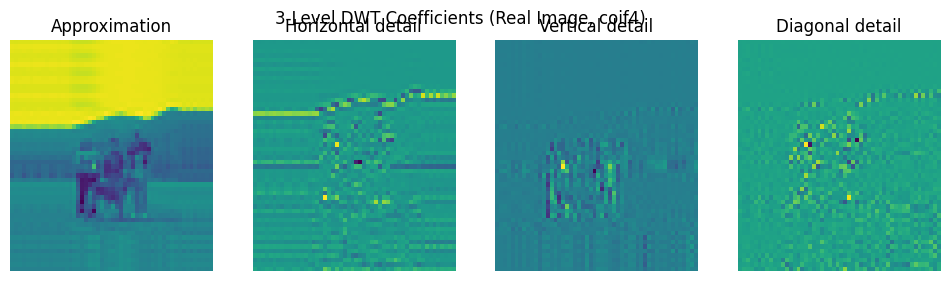

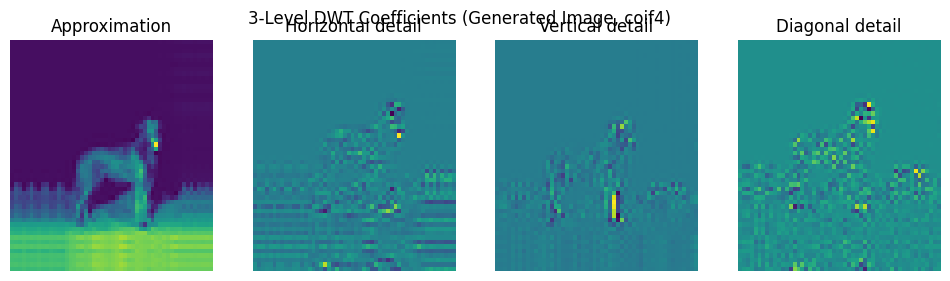

In [ ]:
generated_image = load_image(SRC_PATH + "177/midj/177_midjourney_1.png")
real_image = load_image(SRC_PATH + "177/nature/n02092002_19.JPEG")


real_coeffs = perform_dwt(real_image, wavelet='coif4', level=3)
generated_coeffs = perform_dwt(generated_image, wavelet='coif4', level=3)


plot_dwt_coeffs(real_coeffs, '3-Level DWT Coefficients (Real Image, coif4)')
plot_dwt_coeffs(generated_coeffs, '3-Level DWT Coefficients (Generated Image, coif4)')


In [ ]:
def wavelet_decompose_image(image, wavelet='db2', level=2):
    coeffs = pywt.wavedec2(image, wavelet=wavelet, level=level)
    arr, _ = pywt.coeffs_to_array(coeffs)
    return arr

def plot_wavelet_spectrum(image, title='Scalogram'):
    wavelet_image = wavelet_decompose_image(image)
    plt.imshow(np.log1p(np.abs(wavelet_image)), cmap='viridis')
    plt.title(title)
    plt.axis('off')

def process_and_plot_folder(folder, label):
    images = load_images_from_folder(folder)
    for idx, img in enumerate(images[:5]):  
        plt.figure(figsize=(4, 4))
        plot_wavelet_spectrum(img, title=f'{label} #{idx+1}')
        plt.tight_layout()
        plt.show()

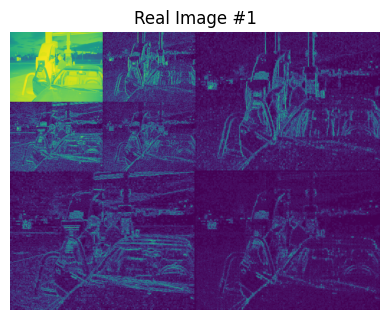

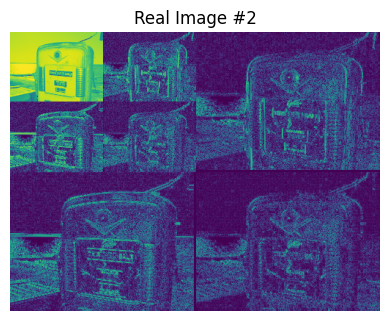

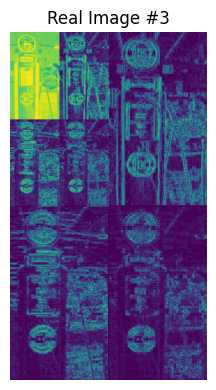

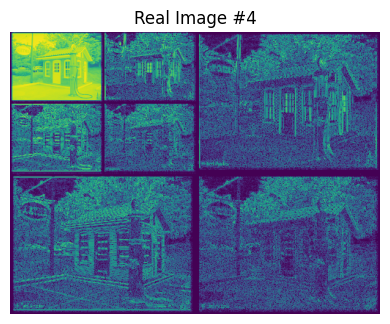

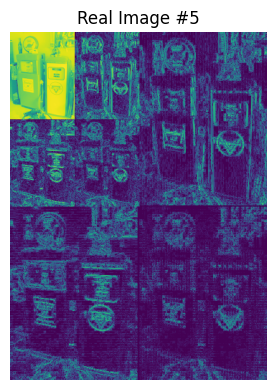

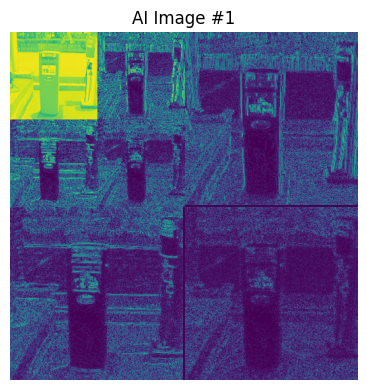

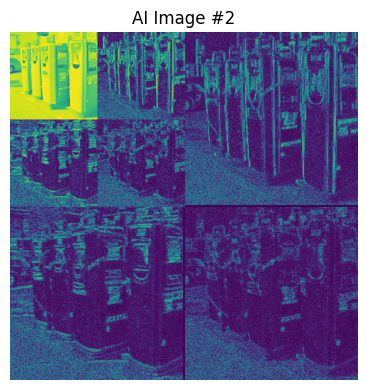

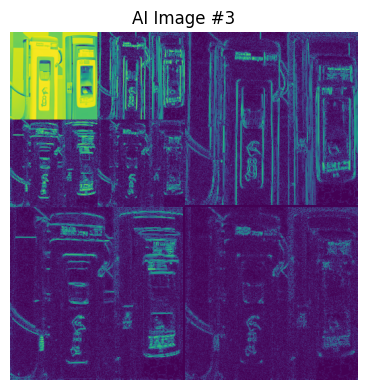

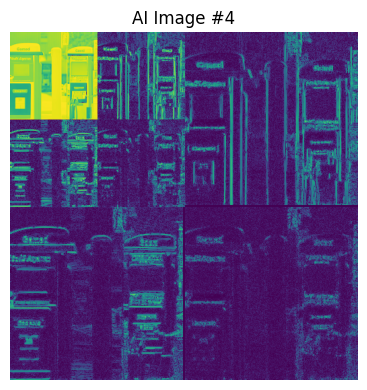

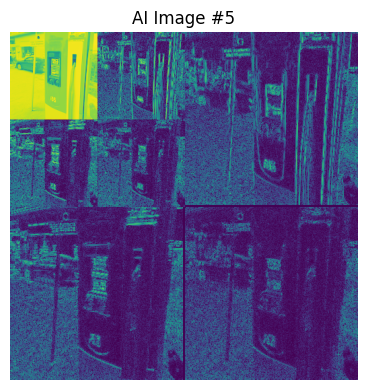

In [45]:
real_images_folder = SRC_PATH + '571/nature'
generated_images_folder = SRC_PATH + "571/sd_15"

process_and_plot_folder(real_images_folder, 'Real Image')
process_and_plot_folder(generated_images_folder, 'AI Image')

## t-SNE and UMAP

In [101]:
from sklearn.manifold import TSNE
import umap

In [106]:
def plot_components(result, labels, path):
    os.makedirs(os.path.dirname(path),exist_ok = True)
    plt.figure(figsize=(10, 8))

    plt.scatter(result[labels==1, 0], result[labels==1, 1], alpha=0.5, label="Real")
    plt.scatter(result[labels==0, 0], result[labels==0, 1], alpha=0.5, label="AI")
    plt.title("Reduced Scattering")
    
    plt.legend()
    plt.tight_layout()    
    plt.savefig(path)
    plt.close()

In [ ]:
def tsne_transform(input_path_ai,input_path_nature, output_path, n_components = 2, size = 256, max_samples = 1000, grey = True):
    ai_imgs = load_images(input_path_ai,(size,size),max_samples,grey)
    # ai_imgs = ai_imgs.reshape(len(ai_imgs), -1)
    nature_imgs = load_images_nature(input_path_nature,size,max_samples,grey)
    # nature_imgs = nature_imgs.reshape(len(nature_imgs), -1)
    print(ai_imgs.shape, nature_imgs.shape)
    all_imgs = np.concatenate([nature_imgs, ai_imgs])
    all_imgs = all_imgs.reshape(len(all_imgs), -1)  # (n_samples, H*W(*3))
    labels = np.array([1]*len(nature_imgs) + [0]*len(ai_imgs))
    tsne = TSNE(n_components=n_components, perplexity=30, random_state=2025)
    tsne_result = tsne.fit_transform(all_imgs)
    plot_components(tsne_result,labels,output_path)
    return tsne,tsne_result


In [110]:
for i in range(10):
    t1, t1r = tsne_transform(f"../Data/GenImage/{classes_idx[i]}/bgan", f"../Data/GenImage/{classes_idx[i]}/nature", f"../Data/tSNE/original/{classes_idx[i]}_bgan.png")
    t2, t2r = tsne_transform(f"../Data/GenImage/{classes_idx[i]}/midj", f"../Data/GenImage/{classes_idx[i]}/nature", f"../Data/tSNE/original/{classes_idx[i]}_midj.png")
    t3, t3r = tsne_transform(f"../Data/GenImage/{classes_idx[i]}/sd_15", f"../Data/GenImage/{classes_idx[i]}/nature", f"../Data/tSNE/original/{classes_idx[i]}_sd_15.png")

100%|██████████| 162/162 [00:00<00:00, 189.85it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 199.80it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 188.80it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:01<00:00, 84.24it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 195.83it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 212.60it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:01<00:00, 89.37it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 217.58it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 219.09it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:01<00:00, 97.79it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 276.24it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 277.14it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:01<00:00, 98.72it/s] 


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 246.18it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 242.06it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:01<00:00, 105.72it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 313.58it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 317.44it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:01<00:00, 102.26it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 296.35it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 274.60it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:01<00:00, 99.94it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:01<00:00, 114.67it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 308.81it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:01<00:00, 99.91it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 257.33it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 242.42it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:01<00:00, 106.92it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 325.28it/s]


(162, 256, 256) (162, 256, 256)


100%|██████████| 162/162 [00:00<00:00, 326.88it/s]


(162, 256, 256) (162, 256, 256)
